### start

In [1]:
import sys  
import os
sys.path.append("../../../")
from nl4dv import NL4DV
import csv 
from vega import VegaLite
import json

with open("vlSpecs_gold.json",'r') as load_f:
    gold_vlSpec = json.load(load_f)
    
def check(dataSet,visId):
    data_path_map = {'movies':'movies-w-year'}
    nl4dv_instance = NL4DV(debug=False,verbose=False,alias_url=os.path.join("..","..","assets","aliases",data_path_map[dataSet]+".json"),data_url=os.path.join("..","..","assets","data",data_path_map[dataSet]+".csv"))
    dependency_parser_config = {'name': 'corenlp','model': os.path.join("..","..","assets","jars","stanford-english-corenlp-2018-10-05-models.jar"),'parser': os.path.join("..","..","assets","jars","stanford-parser.jar")}
    nl4dv_instance.set_dependency_parser(config=dependency_parser_config)
    counter = 0
    with open("utterances.csv") as f:
        f_csv = csv.DictReader(f)
        combo_name = dataSet+'-'+visId
        for row in f_csv:
            if row['visId'].lower() == visId.lower() and row['dataset'].lower() == dataSet.lower():
                counter = counter +1
                print("\033[0;30;46m"+combo_name+"_\033[0m\033[1;30;46m"+str(counter)+"\033[0m\033[0;30;46m:"+row['Utterance Set']+"\033[0m")
                my_response = nl4dv_instance.analyze_query(query=row['Utterance Set'], dialog=False)
                if len(my_response['visList']) == 0:
                    print("\033[1;31;47m"+"No Vis Result!"+"\033[0m")
                else:
                    my_vlSpec = my_response['visList'][0]['vlSpec']
                VegaLite(my_vlSpec).display()

# check('movies','bar')
# nl4dv_instance.render_vis("show me genre and gross").display()
# nl4dv_instance.render_vis("show me genre and gross").display()

# nl4dv_instance.render_vis("show me genre and gross").display()



### 'movies','bar'

dev distribution:
undefined: a new nl4dv instance
movies-bar_1:plot average worldwide growth over major genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'], operator = AVG, values = None
clue: design for QN support at least one task in (['derived_value'])
unmatch: design for QN does not support any extracted ex

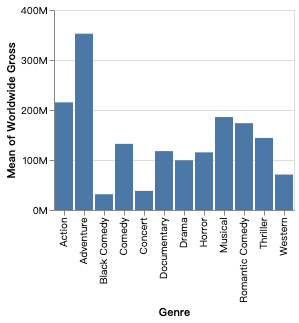

movies-bar_2:show me bars | show me major genre | show me average of worldwide gross
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QN support at least one task in (['derived_value'])
unmatch: design for QN does not support any extracted explicit vis type(None)
SUCCESS: for 

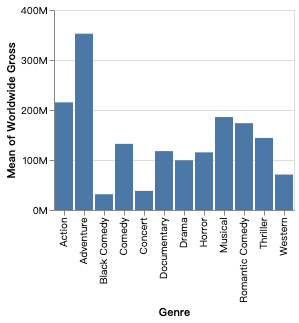

movies-bar_3:Average Worldwide Gross by Major Genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QN support at least one task in (['derived_value'])
unmatch: design for QN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](barchart), this design 

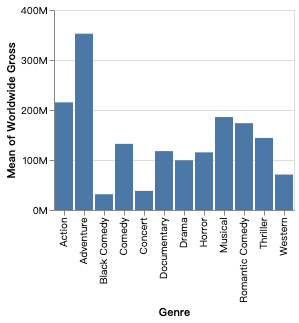

movies-bar_4:make a simple, vertical bar chart of the average of Worldwide sales as a function of the Major Genre.  | Alphabetize the Major Genre, use the color Blue for the bars and extend the grids to the labels only outside the chart.   | Make horizontal gridlines for the Average.
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword vertical, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword blue, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task

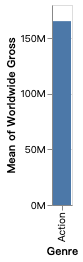

movies-bar_5:Show average worldwide gross by genre. 
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
clue: design for Q

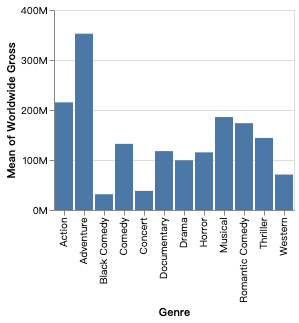

movies-bar_6:Plot the average worldwide gross for each major genre. Sort alphabetically.
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit

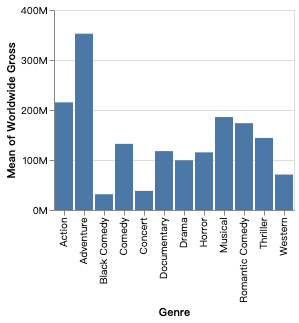

movies-bar_7:What major genre had the highest average worldwide gross?
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['find_extremum', 'derived_value'])
task info (explicit 'dependency analysis' task): 
for task type find_extremum, it has the following 1 task instance:
  find_extremum(queryPhrase == highest): matchScore = 1, attributes = ['Worldwide Gross'], operator = MAX, values = []
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_valu

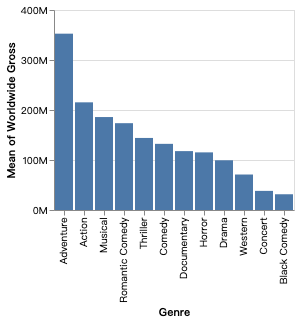

movies-bar_8:What major genre had the lowest average worldwide gross?
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['find_extremum', 'derived_value'])
task info (explicit 'dependency analysis' task): 
for task type find_extremum, it has the following 1 task instance:
  find_extremum(queryPhrase == lowest): matchScore = 1, attributes = ['Worldwide Gross'], operator = MIN, values = []
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value 

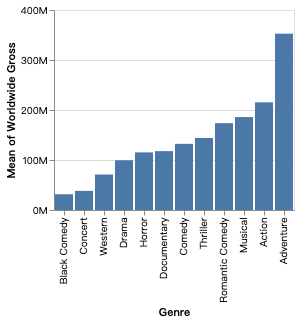

movies-bar_9:How much did average worldwide gross vary by major genre?
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']


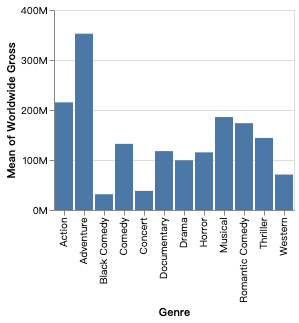

movies-bar_10:Bar chart of average worldwide gross by major genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
clue: des

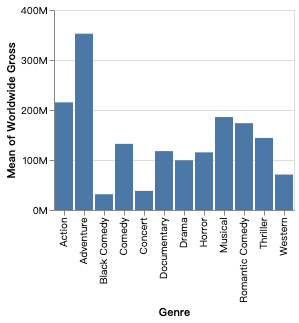

movies-bar_11:show me worldwide gross averaged by major genres
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'], operator = AVG, values = Non

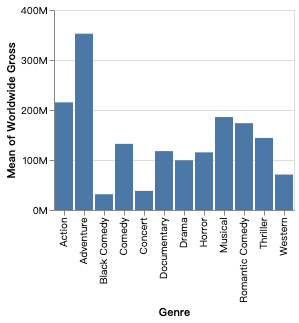

movies-bar_12:Which genre movie makes most worldwide gross
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['find_extremum'])
task info (explicit 'dependency analysis' task): 
for task type find_extremum, it has the following 1 task instance:
  find_extremum(queryPhrase == most): matchScore = 1, attributes = ['Worldwide Gross'], operator = MAX, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase =

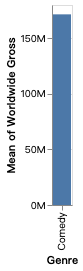

movies-bar_13:what is the worldwide gross distribution per genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 2 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Worldwide Gross'], operator = None, values = []
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Genre'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical

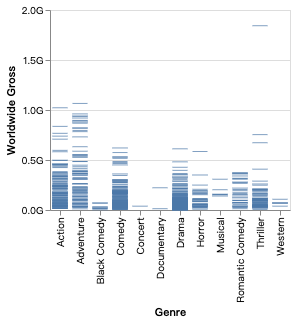

movies-bar_14:gross across genres
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (impli

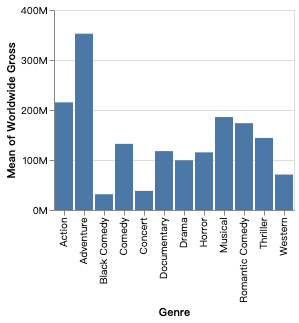

movies-bar_15:Average ww gross by genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (

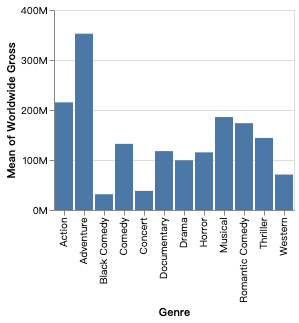

movies-bar_16:On average, how much was earned by movies of each genre?
clue: extract explicit attribute(['Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(

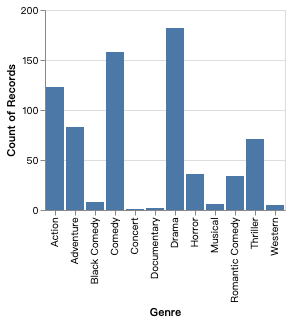

movies-bar_17:bar chart of AVG worldwide gross for movies in each genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_dat

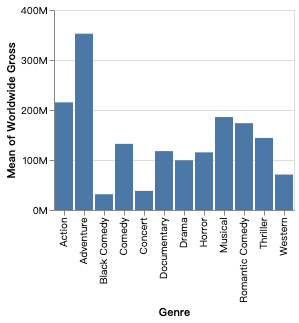

movies-bar_18:What was the average worldwide gross of movies by genre?
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']


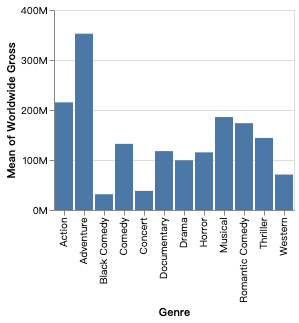

movies-bar_19:Create column graph of worldwide gross by major genre for all movies
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect 

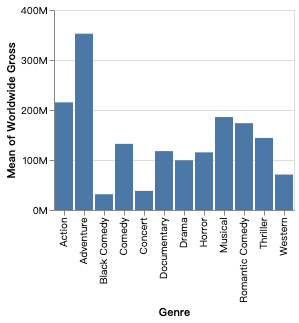

movies-bar_20:How much did major genres gross in total
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase

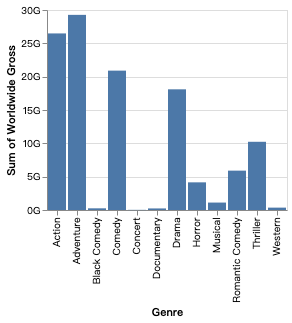

movies-bar_21:average worldwide gross by major genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhra

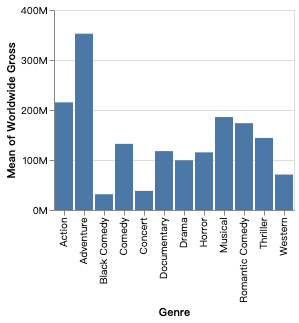

movies-bar_22:avg ww gross by genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (impl

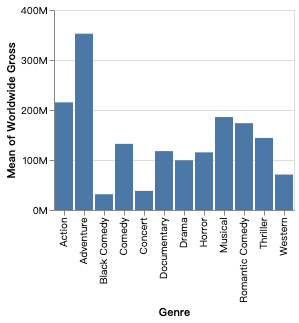

movies-bar_23:Gross versus major genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (i

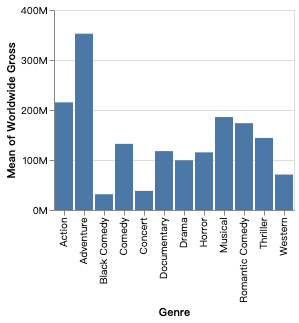

movies-bar_24:Gross versus genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implici

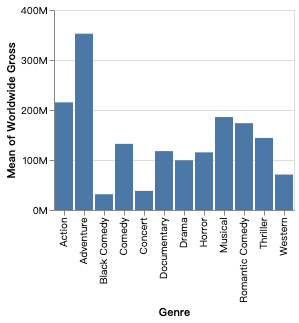

movies-bar_25:Average Worldwide Gross by Major Genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Worldwide Gross'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhra

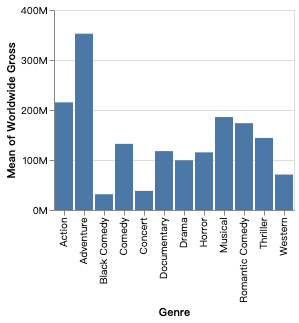

movies-bar_26:show me the average gross revenue of for each genrea
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genrea, it maps to the following 1 attribute:
  Genre(N): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr

movies-bar_27:show me a bar plot where the x axis is movie genre and the y axis is average worldwide revenue


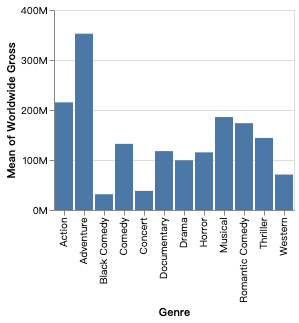

clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical', 'blue']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit', 'Blue Streak']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Scary Movie', 'Disaster Movie']
  filter(que

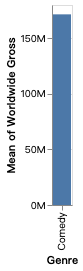

In [2]:
check('movies','bar')

### 'movies','groupedBar'

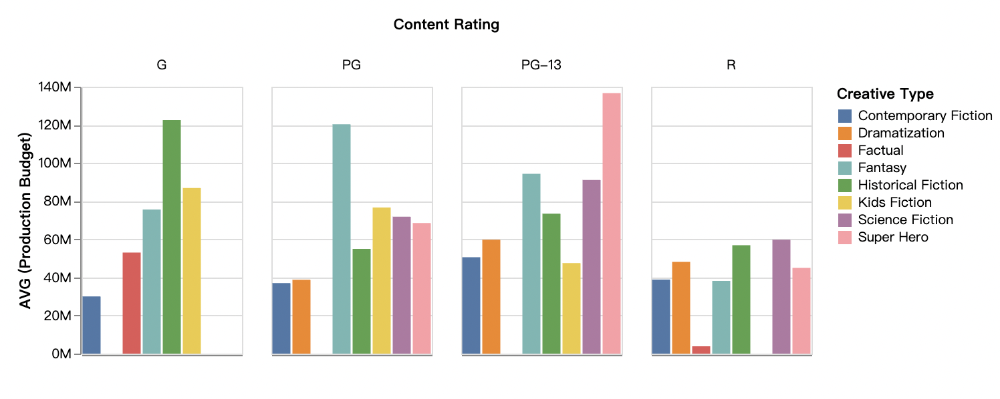

dev distribution:
undefined: a new nl4dv instance
movies-groupedBar_1:show me average budget split by content rating colored by creative type
clue: extract explicit attribute(['Content Rating', 'Creative Type', 'Production Budget'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase =

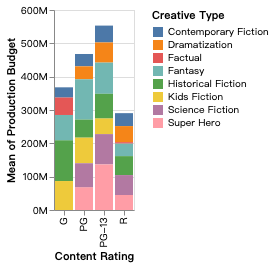

movies-groupedBar_2:Avg(Poduction Budget) Grouped by Content Rating and sub-grouped by Creative Type
clue: extract explicit attribute(['Content Rating', 'Creative Type', 'Production Budget'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['P

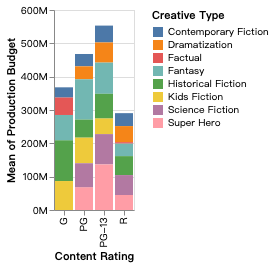

movies-groupedBar_3:Make vertical bar charts of the average of the Production Budget categorized by Creative Type and parameterized by Content Rating across the page. | Put an alphabetized legend for Creative type on the right side of the page. Do not use an x-axis or category axis but use the same axis for each chart. Use only major average of Production Budget gridlines.
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword vertical, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5,

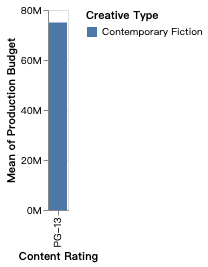

movies-groupedBar_4:Show me the average production budget for each movie type, broken down by content rating.
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['

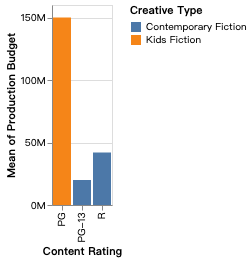

movies-groupedBar_5:What creative type of movie had the highest production budget for each content rating?
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['find_extremum'])
task info (explicit 'dependency analysis' task): 
for task type find_extremum, it has the following 1 task instanc

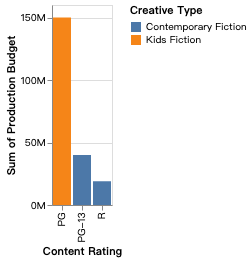

movies-groupedBar_6:Average production budget by Creative Type, with separate graphs by Content Rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract expl

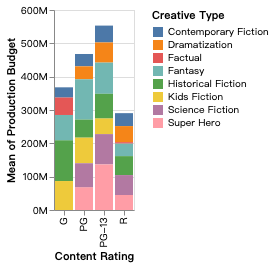

movies-groupedBar_7:show me bar charts of average production budget by creative types grouped by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: ex

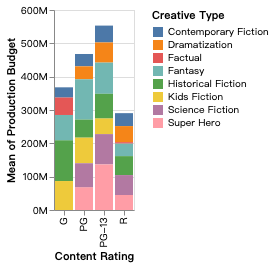

movies-groupedBar_8:What's the average production budget of the different rated movies, separated by creative type.
clue: extract explicit attribute(['Production Budget', 'Creative Type', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rated, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis'

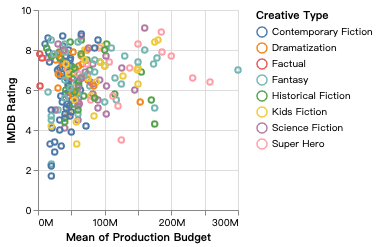

movies-groupedBar_9:what's the breakdown of production budget by creative type per content rating?
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit']
  filter(queryPhrase == ['movie', 'broken']): matc

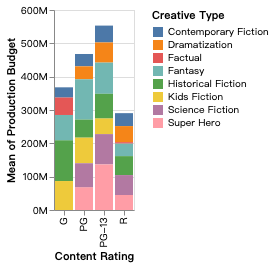

movies-groupedBar_10:What was the average budget for each content rating and creative type, as multiple column charts
clue: extract explicit attribute(['Content Rating', 'Creative Type', 'Production Budget'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: e

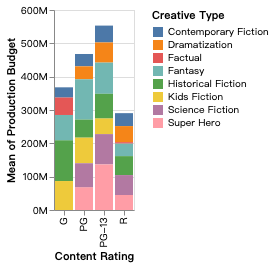

movies-groupedBar_11:For each content rating, show a column chart of average production budget by creative type
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: ext

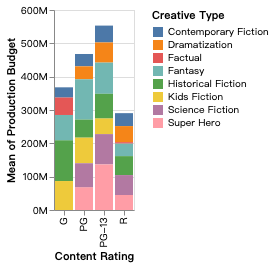

movies-groupedBar_12:bar chart for each rating, showing avg production budget per creative type
clue: extract explicit attribute(['Production Budget', 'Creative Type', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit

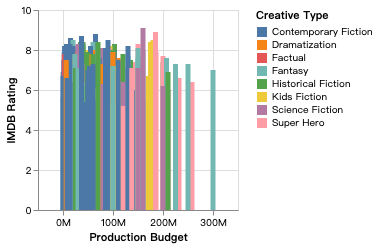

movies-groupedBar_13:Display column graph of average production budget by creative type broken down by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type', 'Title'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 

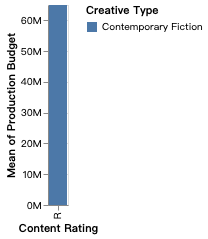

movies-groupedBar_14:i want to see the average production budget of each creative type in a column chart, and grouped together by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], oper

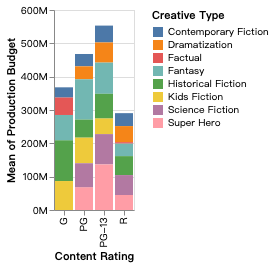

movies-groupedBar_15:budget vs content rating regarding different creative types
clue: extract explicit attribute(['Content Rating', 'Creative Type', 'Production Budget'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit']
  filter(queryPhrase == ['movie', 'broken']): matchScore = 1, attribute

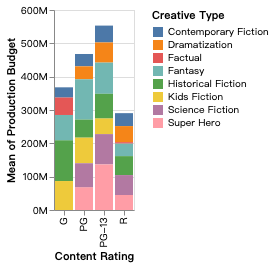

movies-groupedBar_16:average production budget by creative type and content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract explicit 'domain_value f

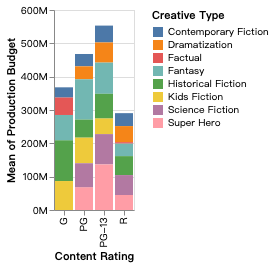

movies-groupedBar_17:average production budget with creative type as legend and trellised by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword legend, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_synonym_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:


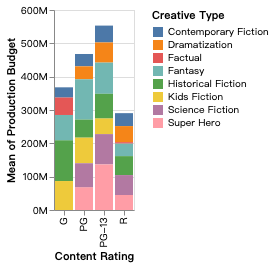

movies-groupedBar_18:Production budget for each creative type, by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit']
  filter(queryPhrase == ['movie', 'broken']): matchScore = 1, attrib

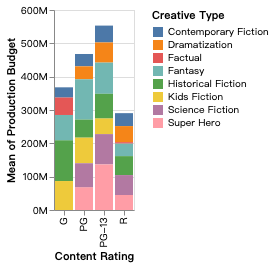

movies-groupedBar_19:Average Production Budget by Creative Type filtered by Content Rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract explicit 'domain

movies-groupedBar_20:Average Production Budget by Creative Type separated by Content Rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


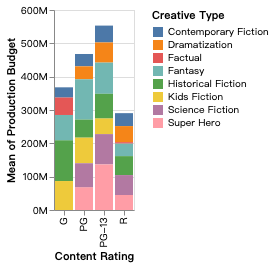

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit']
  filter(queryPhrase == ['movie', 'broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Disaster Movie', 'Scary Movie', 'Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Disaster Movie', 'Scary Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
clue: design

movies-groupedBar_21:show me average production budget of each creative type across content ratings.
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Creative Type'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


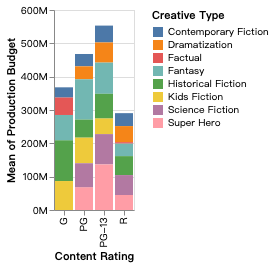

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['vertical']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Vertical Limit']
  filter(queryPhrase == ['movie', 'broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Disaster Movie', 'Scary Movie', 'Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Epic Movie', 'Disaster Movie', 'Scary Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
clue: design

movies-groupedBar_22:show me small multiples of average production budget for each creative type across different ratings


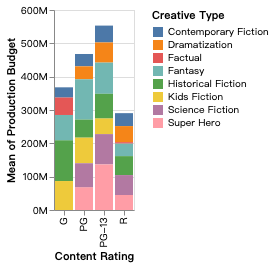

clue: extract explicit attribute(['Production Budget', 'Creative Type', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword ratings, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword small, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explic

movies-groupedBar_23:show me how each rating, broken down by creative type, affects the average production budget


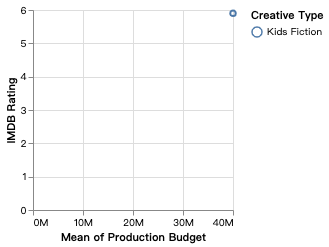

clue: extract explicit attribute(['Production Budget', 'Creative Type', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explic

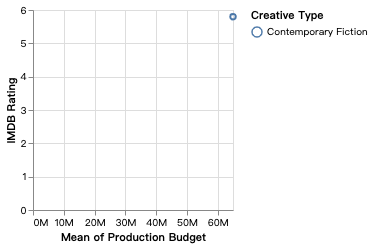

In [3]:
check('movies','groupedBar')

### 'movies','histogram'

dev distribution:
undefined: a new nl4dv instance
movies-histogram_1:draw bars | show me running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for desi

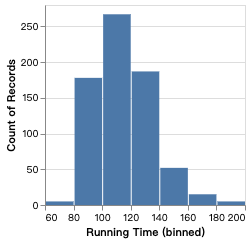

movies-histogram_2:histogram of running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 3.5


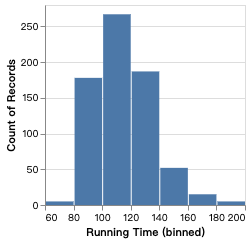

movies-histogram_3:give me the number of movies by running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is appen

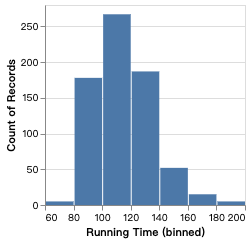

movies-histogram_4:histogram of Running Time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 3.5


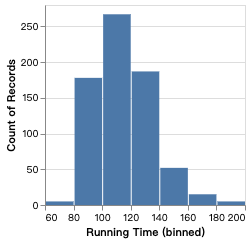

movies-histogram_5:Make a simple bar chart of count of Titles versus the Running Time. | Extend axes to labels and use only Count or lateral gridlines.
clue: extract explicit attribute(['Title', 'Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword titles, it maps to the following 1 attribute:
  Title(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(barchart)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any spe

movies-histogram_6:Show the number of films categorized by their running times.
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running times, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


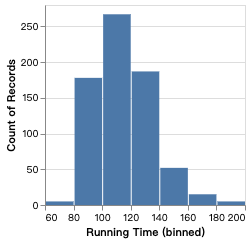

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 2.5
SUCCESS: for design[2](boxplot), this design is append with score 2.5


movies-histogram_7:Plot a histogram of movie running time.
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(histogram)


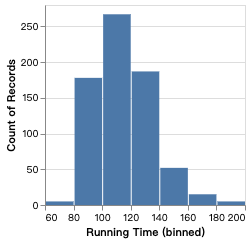

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['filter', 'distribution'])
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 4.5


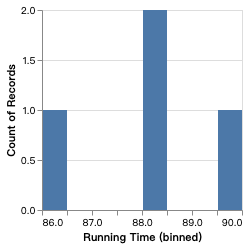

movies-histogram_8:What is the distribution of running times for each movie?
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword running times, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 1 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Running Time'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary

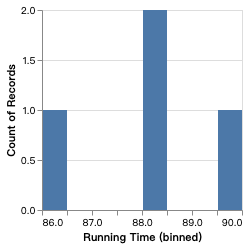

movies-histogram_9:Histogram of running time, in 20 minute bands
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
implicit inference: for design[0](histogram

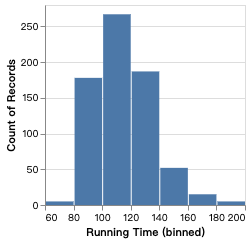

movies-histogram_10:Movie run time distribution
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword run time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 1 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Running Time'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'E

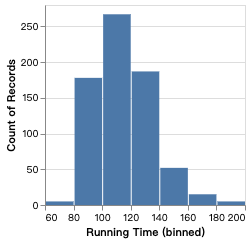

movies-histogram_11:Show a count of movies binned by running time in 20-minute increments.
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: desig

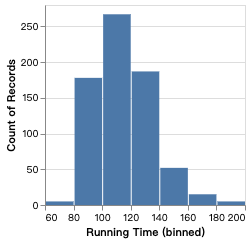

movies-histogram_12:Show me count of movie runtimes 
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword runtimes, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], ope

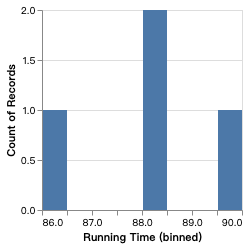

movies-histogram_13:average length of movies
clue: extract explicit attribute([])
attribute info: 
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
FAILURE: final vis_list is empty
No Vis Result!


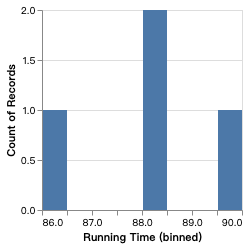

movies-histogram_14:Give me a histogram of the number of movies by running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task 

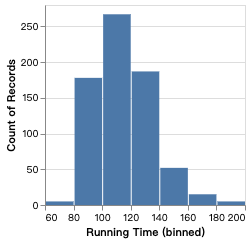

movies-histogram_15:How many movies are of each length?
clue: extract explicit attribute([])
attribute info: 
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
FAILURE: final vis_list is empty
No Vis Result!


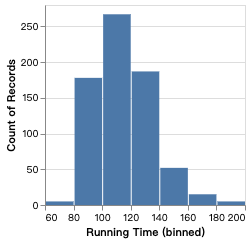

movies-histogram_16:Count the movies by how long they are
clue: extract explicit attribute([])
attribute info: 
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
FAILURE: final vis_list is empty
No Vis Result!


movies-histogram_17:Show a histogram of the number of movies by how long they are
clue: extract explicit attribute([])
attribute info: 
clue: extract explicit vis type(histogram)


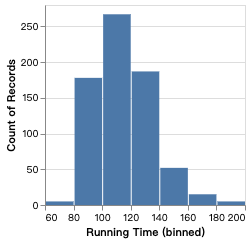

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
FAILURE: final vis_list is empty
No Vis Result!


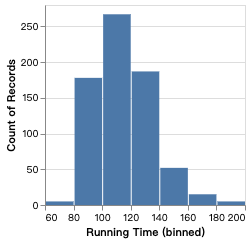

movies-histogram_18:Count movies by how long they are to the nearest 20 minutes
clue: extract explicit attribute(['Title'])
attribute info: 
for keyword  minutes, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): ma

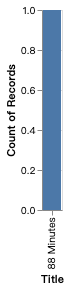

movies-histogram_19:Count movies by length in 20 minute buckets
clue: extract explicit attribute([])
attribute info: 
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
FAILURE: final vis_list is empty
No Vis Result!


movies-histogram_20:histogram of running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)


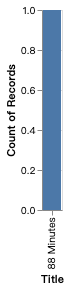

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
implicit inference: for design[0](histogram), since mandatory channel y is

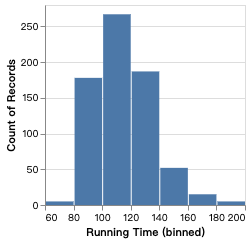

movies-histogram_21:Show me a boring bar chart of movie running time and count
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attribut

movies-histogram_22:Give me a histogram of running time for movies
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)


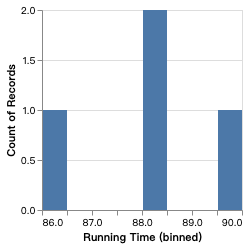

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_da

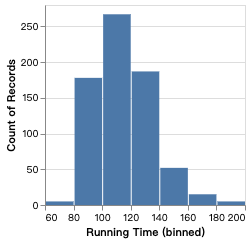

movies-histogram_23:Create histogram of running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attribu

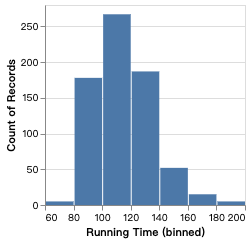

movies-histogram_24:breakdown of movies by running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, a

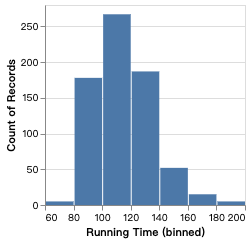

movies-histogram_25:show me the count of movies by running time buckets
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): m

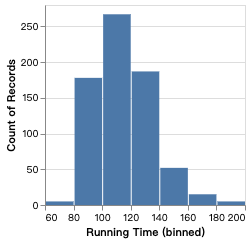

movies-histogram_26:count of movies by binned running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1

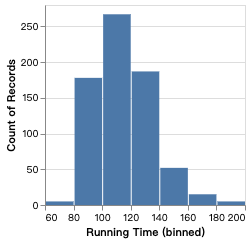

movies-histogram_27:"what's the distribution of running times by movie
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword running times, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 1 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Running Time'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie

movies-histogram_28:how many movies are there in 20 minute bins of running time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


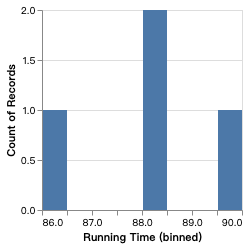

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], opera

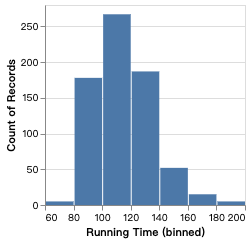

movies-histogram_29:running time distribution
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 1 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Running Time'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 

movies-histogram_30:running time distribution, buckets of 20 minutes for running time
clue: extract explicit attribute(['Running Time', 'Title'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword  minutes, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


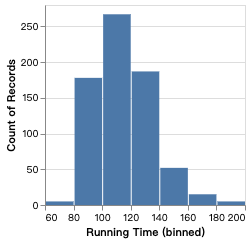

clue: extract explicit 'dependency analysis' task(['distribution'])
task info (explicit 'dependency analysis' task): 
for task type distribution, it has the following 1 task instance:
  distribution(queryPhrase == distribution): matchScore = 1, attributes = ['Running Time'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
 

movies-histogram_31:running time in 20 minute buckets
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


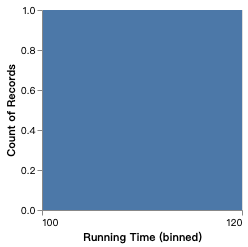

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['88 Minutes']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], opera

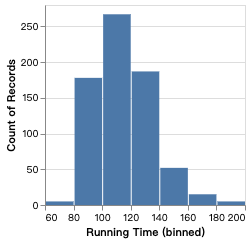

movies-histogram_32:Total Count based on Running Time
clue: extract explicit attribute(['Running Time'])
attribute info: 
for keyword running time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, att

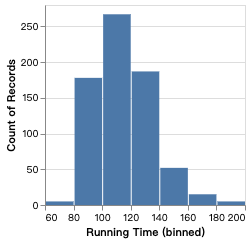

movies-histogram_33:show me a histogram of movie length
clue: extract explicit attribute(['Title'])
attribute info: 
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == [' minutes']): matchScore = 1, attributes = ['T

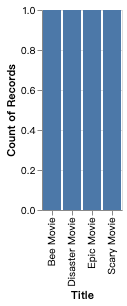

In [2]:
check('movies','histogram')

### 'movies','line'

dev distribution:
undefined: a new nl4dv instance
movies-line_1:what's the production budget for movies in different years?
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword years, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Production Budget', 'Release Year'], operator = None, values = None
clue: design for QT support at least one task in (['trend'])
unmatch: design for Q

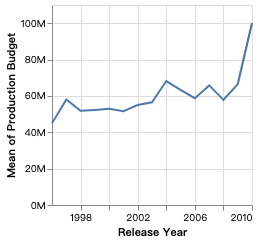

movies-line_2:Average Production Budget by Year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS: for design

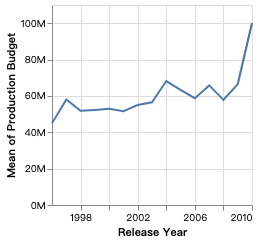

movies-line_3:make a simple line chart of the average of the Production Budget as a function of  Release Year.  | use no symbols, use a 1 pt line, and use gridlines for both average and release year.
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for

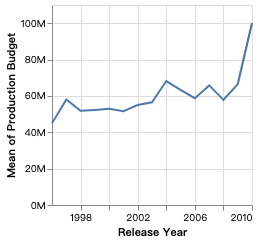

movies-line_4:Show the trend in average production budgets from 1995 to 2010.
clue: extract explicit attribute(['Production Budget'])
attribute info: 
for keyword production budgets, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for Q does not support any task in (['derived_value'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the att

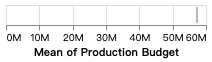

movies-line_5:Plot the average production budget each year across all movies.
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis 

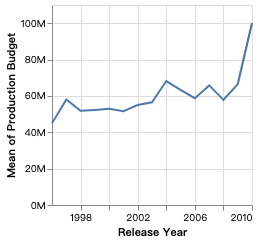

movies-line_6:What is the relationship between release year and average production budget?
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value', 'correlation'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 0 task instance:
for task type correlation, it has the following 0 task instance:
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0

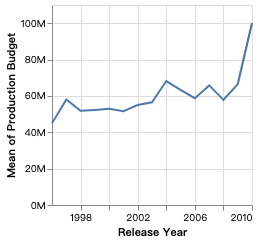

movies-line_7:Line graph of average Production Budget across Release Year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
SUCCESS: for design[0](linechart), this design is append with score 6.0


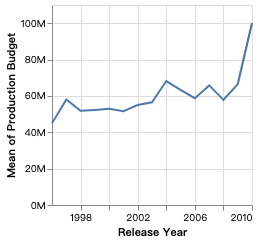

movies-line_8:plot average production budget over release year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUC

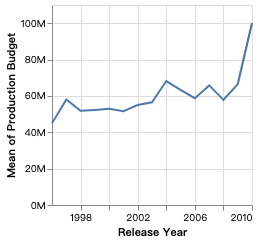

movies-line_9:show me average production budget over release year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)


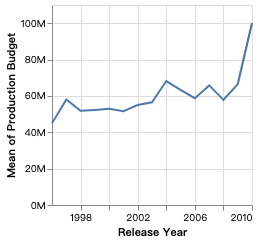

movies-line_10:How production budge changes over release years?
clue: extract explicit attribute(['Release Year', 'Production Budget'])
attribute info: 
for keyword release years, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword production, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Production Budget', 'Release Year'], operator = None, values = None
clue: design for QT support at least one task in (['trend'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SU

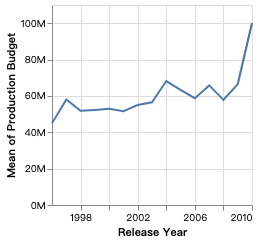

movies-line_11:What was the average production budget of movies by year?
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(

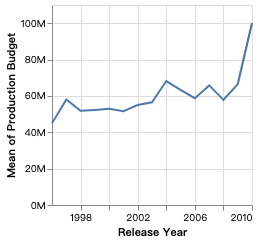

movies-line_12:I want to see trend of production budget by the release year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
datatype_ambiguous: task is trend, but the corresponding attribute is not T type
clue: extract explicit 'dependency analysis' task(['trend'])
task info (explicit 'dependency analysis' task): 
for task type trend, it has the following 1 task instance:
  trend(queryPhrase == trend): matchScore = 1, attributes = ['Production Budget'], operator = None, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QT support at least one task in (['trend'])
unmatch: design for QT 

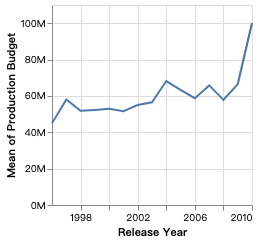

movies-line_13:budget over time
clue: extract explicit attribute(['Production Budget', 'Running Time'])
attribute info: 
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.3


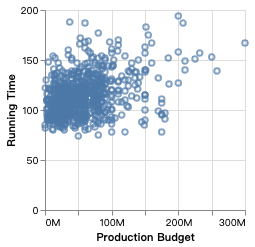

movies-line_14:production budget across years
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword years, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Production Budget', 'Release Year'], operator = None, values = None
clue: design for QT support at least one task in (['trend'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS: for design[0

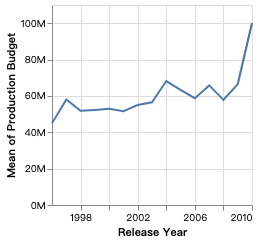

movies-line_15:Average budget by year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart)

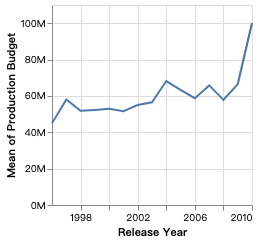

movies-line_16:What is the average production budget in each year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
S

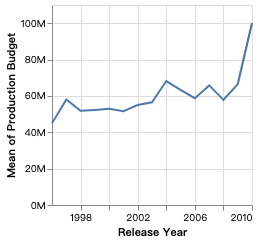

movies-line_17:Give me a line chart of average budget by year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(linechart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
SUCCESS: for design[0](linechart), this design is append with score 5.8


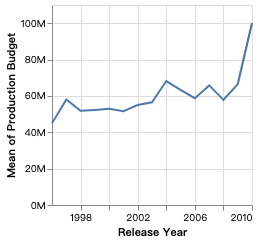

movies-line_18:line chart of AVG production budget of each release year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Production Budget', 'Release Year'], operator = None, values = None
clue: design for QT support at least one task in (['trend'])
SUCCESS: for design[0](linechart), this design is append with score 5.0
unma

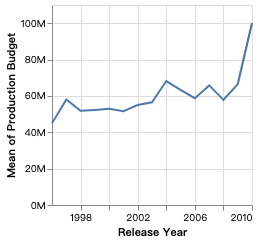

movies-line_19:Display production budget by release date
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Production Budget', 'Release Year'], operator = None, values = None
clue: design for QT support at least one task in (['trend'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS:

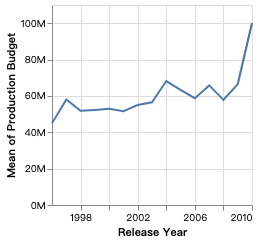

movies-line_20:show me the average production budget by release year in a line chart
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
SUCCESS: for design[0](linechart), this design is append with 

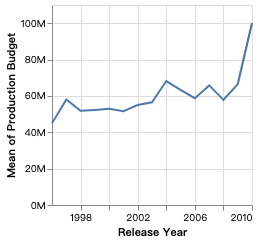

movies-line_21:average production budget over time
clue: extract explicit attribute(['Production Budget', 'Running Time'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QQ does not support any task in (['derived_value'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for des

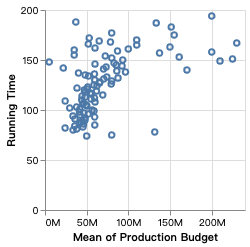

movies-line_22:average production budget by year
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS: for desig

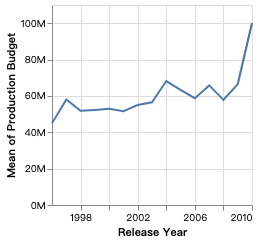

movies-line_23:avg production budget over time
clue: extract explicit attribute(['Production Budget', 'Running Time'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.4


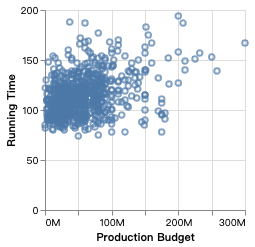

movies-line_24:average production budget by year, 1995 to 2009
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCC

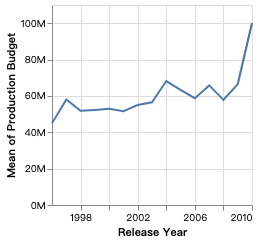

movies-line_25:Yearly average Production Budget
clue: extract explicit attribute(['Production Budget', 'Release Year'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword yearly, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.8, metric = attribute_alias_exact_match
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design for QT does not support any task in (['derived_value'])
unmatch: design for QT does not support any extracted explicit vis type(None)
SUCCESS: for design[

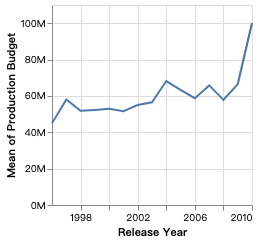

movies-line_26:show me a line plot of average movie production budget over time for all movies
clue: extract explicit attribute(['Production Budget', 'Running Time', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == average): matchScore = 1, attributes = ['Production Budget'], operator = AVG, values = []
clue: extract explicit 'domain_value filter' tas

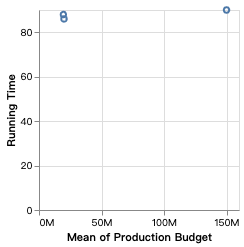

movies-line_27:show me small multiple scatter plots of movie production budget vs gross worldwide where each multiple is a specific rating
clue: extract explicit attribute(['Production Budget', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_simila

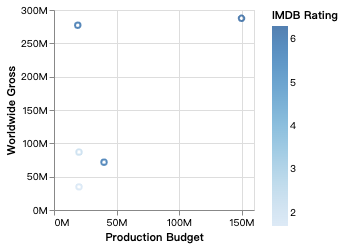

In [3]:
check('movies','line')

### 'movies','multiLine'

dev distribution:
undefined: a new nl4dv instance
movies-multiLine_1:give me line charts of worldwide gross over year by major genres
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Release Year'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'

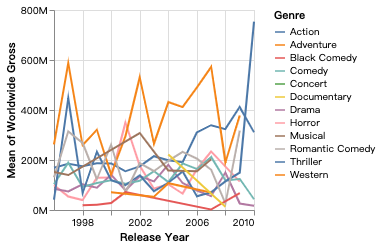

movies-multiLine_2:plot worldwide gross over release year split by genre
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
un

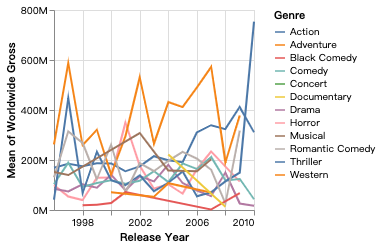

movies-multiLine_3:time series: Sum(Worldwide Gross) by Release Year | group and color code by Major Genre
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre', 'Running Time'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(linechart)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_co

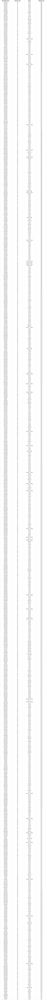

movies-multiLine_4:plot a simple line chart that Sums the Worldwide Gross of major films versus release year parameterized by Major Genre. | Do not use symbols and show only major gridlines. Extend the axis to the labels. 
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit 

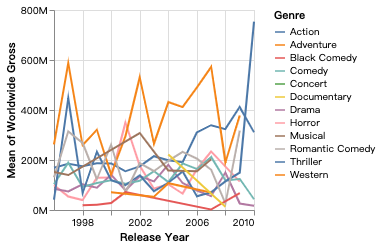

movies-multiLine_5:Show how genres have been associated with worldwide grosses from 1995 to 2009.
clue: extract explicit attribute(['Worldwide Gross', 'Genre'])
attribute info: 
for keyword worldwide grosses, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'], operator = AVG, values = None
clue: design for QN support at least one task in (['derived_value'])
unmatch: design for QN does not support any extracted explicit vis

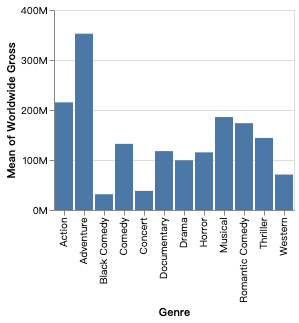

movies-multiLine_6:Plot the total worldwide gross over time for each major genre.
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Running Time'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: design 

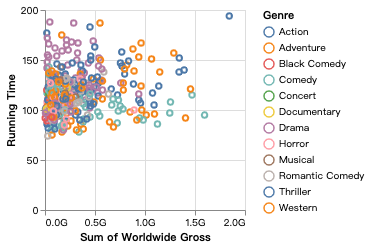

movies-multiLine_7:What is the total worldwide gross for each major genre across time?
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Running Time'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
missing: cannot extract any explicit 'domain_value filter' task
unmatch: de

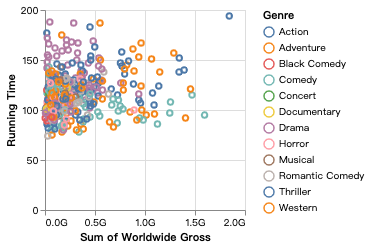

movies-multiLine_8:Line graph of total Worldwide Gross by Major Genre, across Release Year
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: des

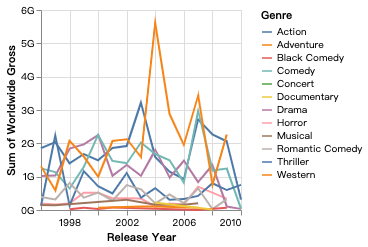

movies-multiLine_9:Show worldwide gross timeline by movie genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo

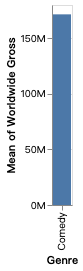

movies-multiLine_10:Show a time series plot by year of the worldwide gross sum of movies by genre.
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Release Year', 'Running Time'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(linechart)
datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task typ

movies-multiLine_11:Total gross by year and genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


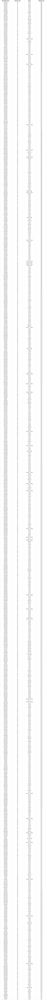

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 2 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Release Year'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNT support at least one task in (['derived_value'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
auto correction: for design[0](linechart), since datatype_ambiguous problem happened in der

movies-multiLine_12:Total gross by genre and year
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


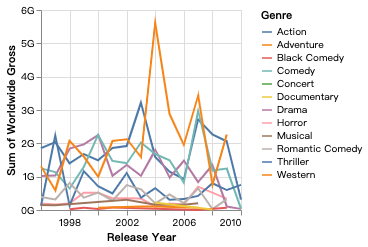

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 2 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Genre'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNT support at least one task in (['derived_value'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
auto correction: for design[0](linechart), since datatype_ambiguous problem happened in derived_va

movies-multiLine_13:Gross by genre and year
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


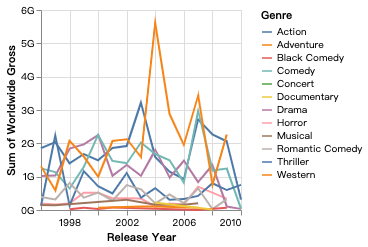

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart), this design is append with score 5.8
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: 

movies-multiLine_14:Gross, year and genre as a line chart
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(linechart)


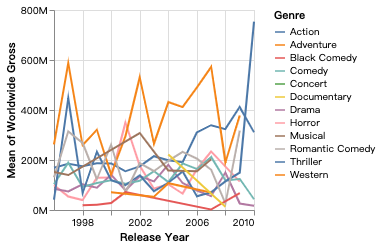

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
SUCCESS: for design[0](linechart), this design is append with score 6.8
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](linechart), this design is append with score 6.8


movies-multiLine_15:Show the total gross across genres over time
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Running Time'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


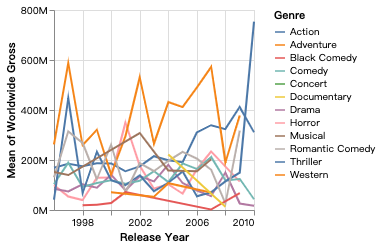

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
unmatch: design for QQN does not support any task in (['derived_value'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.8
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design

movies-multiLine_16:line chart of total worldwide gross over each release year, line for each genre
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(linechart)


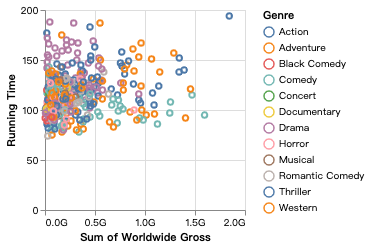

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNT support at least one task in (['derived_value'])
SUCCESS: for design[0](linechart), this design is append with score 8.0
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](linechart), this design is append with score 8.0
unmatch: for design[5](stripplot)

movies-multiLine_17:gross per genre over time
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Running Time'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


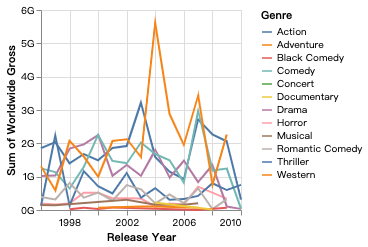

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.3
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.3
unmatch: for design[2](stripplot), directly give up this design since we have other des

movies-multiLine_18:Show me the total worldwide gross over time by release year for the major genres
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre', 'Running Time'])
attribute info: 
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


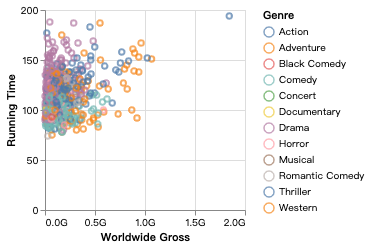

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']


movies-multiLine_19:release year vs worldwide gross in genres
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


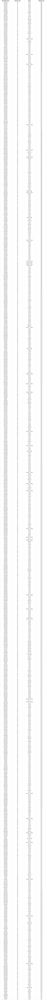

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart), this design is append with score 6.0
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: 

movies-multiLine_20:ww gross over time by genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Running Time'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


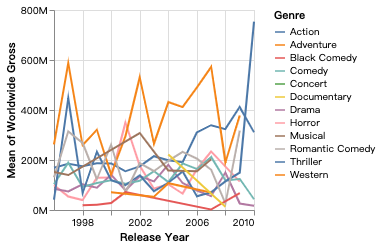

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.3
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.3
unmatch: for design[2](stripplot), directly give up this design since we have other des

movies-multiLine_21:total worldwide gross by release year and major genre
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


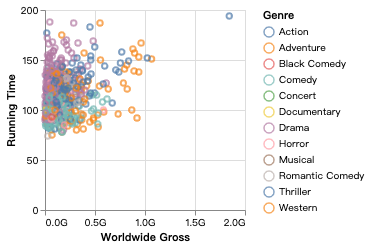

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 2 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Release Year'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNT support at least one task in (['derived_value'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
auto correction: for design[0](linechart), since datatype_ambiguous problem happened in der

movies-multiLine_22:Create timeline of worldwide gross by release year displayed by major genre
clue: extract explicit attribute(['Worldwide Gross', 'Release Year', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword release year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


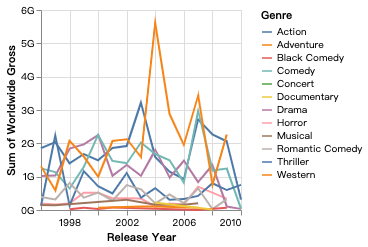

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart), this design is append with score 6.0
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: 

movies-multiLine_23:line graph of worldwide gross for each genre for each year starting in 1995 to present
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(linechart)


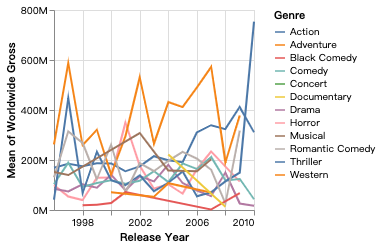

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
SUCCESS: for design[0](linechart), this design is append with score 6.9
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](linechart), this design is append with score 6.9


movies-multiLine_24:worldwide gross for each genre for each year 1995 to now
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


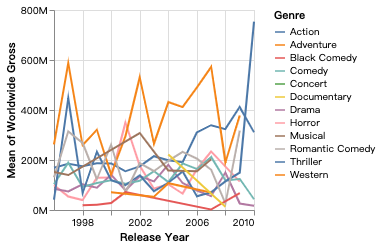

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart), this design is append with score 5.9
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: 

movies-multiLine_25:Worldwide Gross through time for each Major Genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Running Time'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


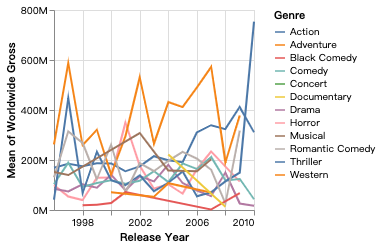

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.4
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.4
unmatch: for design[2](stripplot), directly give up this design since we have other des

movies-multiLine_26:Yearly Worldwide Gross for each Major Genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword yearly, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.8, metric = attribute_alias_exact_match
missing: cannot extract any explicit vis type


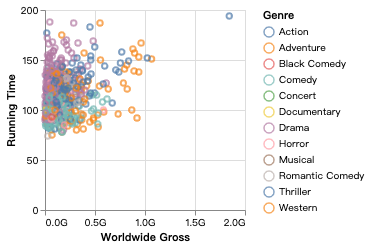

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(QNT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross', 'Genre', 'Release Year'], operator = None, values = None
unmatch: design for QNT does not support any task in (['trend'])
unmatch: design for QNT does not support any extracted explicit vis type(None)
SUCCESS: for design[0](linechart), this design is append with score 5.8
implicit inference: for design[1](linechart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: 

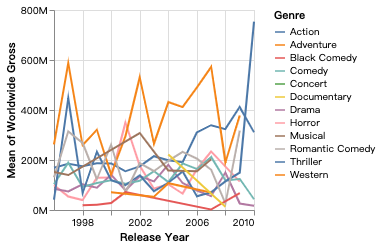

movies-multiLine_27:show me how total gross revenue of all movies changes over a year for each genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Release Year'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword year, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since

movies-multiLine_28:show me a line plot of sum of gross revenue for each genre over time
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Running Time'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


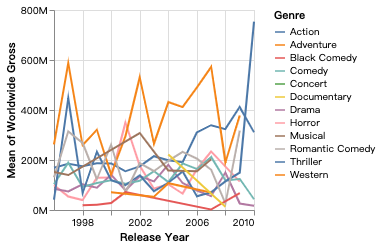

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.3
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.3
unmatch: for design[2](stripplot), directly give up this design since we have other des

movies-multiLine_29:show me how gross revenue of genres changes over time
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Running Time'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword time, it maps to the following 1 attribute:
  Running Time(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


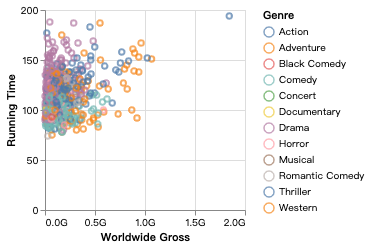

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.3
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.3
unmatch: for design[2](stripplot), directly give up this design since we have other des

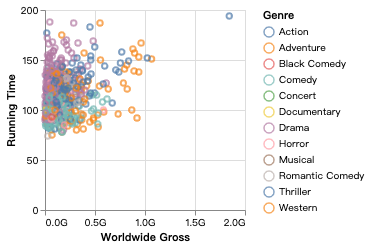

In [4]:
check('movies','multiLine')

### 'movies','scatter'

dev distribution:
undefined: a new nl4dv instance
movies-scatter_1:Relationship between IMDB Rating and Rotten Tomatoes Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Rotten Tomatoes Rating', 'IMDB Rating'], operator = None, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QQ support at least one task in (['corre

movies-scatter_2:show me imdb rating versus rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


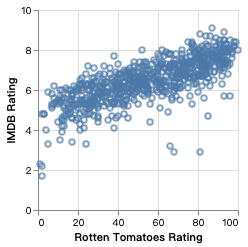

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_3:give me a scatterplot of imdb rating as x axis and rotten tomatoes rating as y axis
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


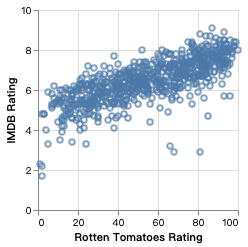

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_4:show me a scatterplot | show me rating | show me rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


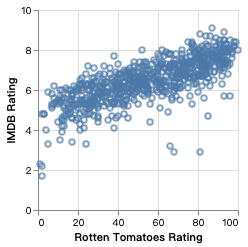

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(scatterplot)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 3.5


movies-scatter_5:Plot IMDB rating against Rotten Tomatoes rating.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


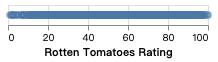

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_6:scatter IMDB Rating vs Rotten Tomatoes Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


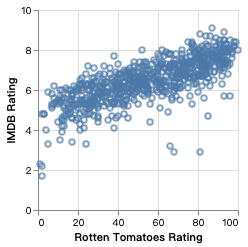

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


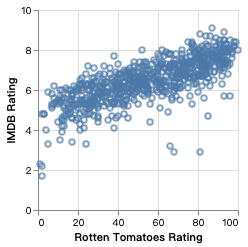

movies-scatter_7:Make a simple scatter plot of Rotten Tomatoes Rating versus IMDB Rating.   | Use only major gridlines.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


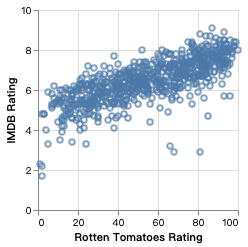

movies-scatter_8:Show how films' Rotten Tomato ratings compare with IMDB ratings.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomato ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


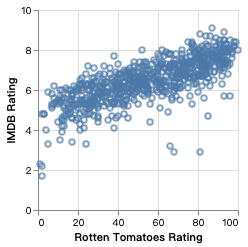

movies-scatter_9:Plot rotten tomatoes rating v.s. IMDB rating on a scatter plot.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_10:Is there a relationship between IMDB rating and rotten tomatoes rating?
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


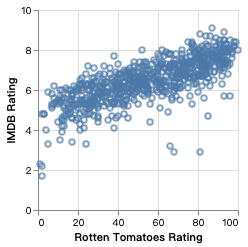

clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Rotten Tomatoes Rating', 'IMDB Rating'], operator = None, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 5.0


movies-scatter_11:Scatterplot of Rotten Tomatoes Rating by IMDB Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


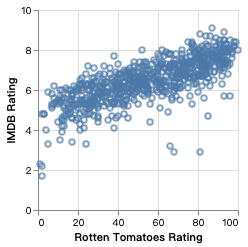

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_12:plot IMDB rating against rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


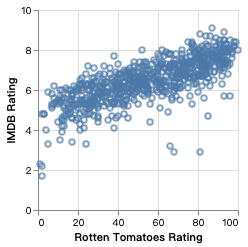

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_13:Are IMDb rating and rotten tomatoes rating related
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


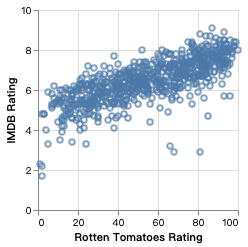

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_14:Rating of movies in IMBD and Rotten Tomatoes
clue: extract explicit attribute(['Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rating, it maps to the following 2 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


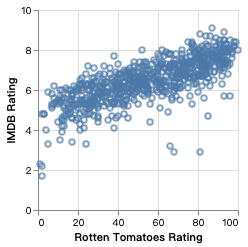

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Rotten Tomatoes Rating'], operator = AVG, values = None
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QN support at least one task in (['derived_value', 'correlation'])
unmatch: design for QN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](barchart), this design is append with score 3.8
unsuggested: for design[1](piechart), the design is not suggested by default
unsuggested: for design[2](donutchart), the design is not suggested by default
unmatch: for design[3](stripplot), directly give up this design since we have other design that can match the task better
clu

movies-scatter_15:how does Rotten Tomatoes Rating change as IMDB Rating?
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


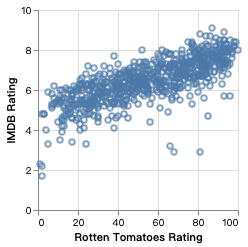

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_16:Compare imdb rating to rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


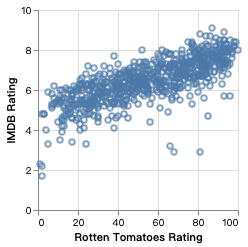

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_17:Show a scatter plot of imdb rating vs rotten tomatoes rating


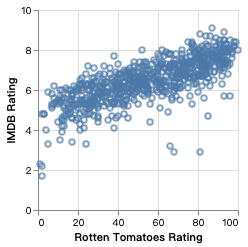

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_18:Give me a scatter plot showing a comparison of ratings between imdb and rotten tomatoes


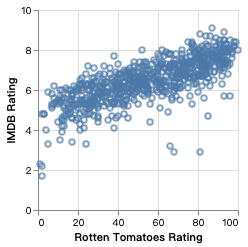

clue: extract explicit attribute(['Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword imdb, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.2
implicit inference: for design[1](scatterplot), since m

movies-scatter_19:scatter plot of IMDB rating vs Rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


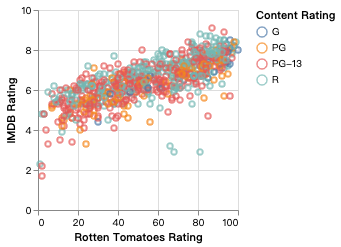

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_20:Plot IMBD vs Rotten Tomatoes ratings for all movies
clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


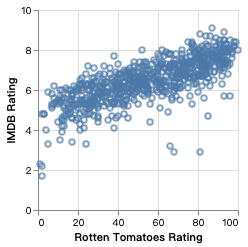

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 2.5
SUCCESS: for design[2](boxplot), this design is append with score 2.5


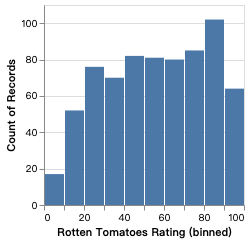

movies-scatter_21:Help me see outliers in IMDB and Rotten Tomatoes ratings
clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for 

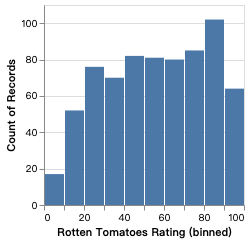

movies-scatter_22:IMDB rating by rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_23:Show me a scatterplot of movies by imdb rating and rotten tomatoes rating


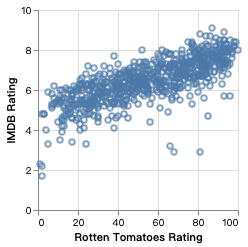

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_24:scatter of imdb rating by rotting tomatoes rating
clue: extract explicit attribute(['IMDB Rating', 'Rotten Tomatoes Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)


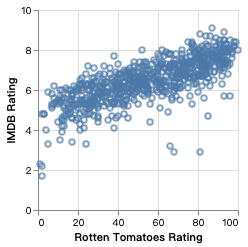

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.4


movies-scatter_25:imdb rating vs rotten tomatoes rating by movie
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


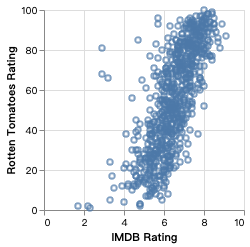

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['filter', 'correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_26:Create scatter graph of IMDB rating by Rotten Tomatoes Rating 
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


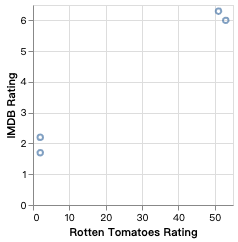

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_27:relation between rotten tomatoes rating and IMDB rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


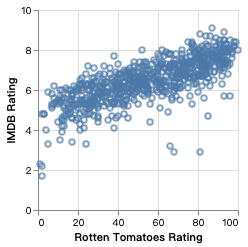

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_28:relation between rotten tomatoes and IMDB ratings
clue: extract explicit attribute(['IMDB Rating'])
attribute info: 
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


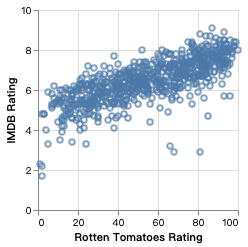

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 2.5
SUCCESS: for design[2](boxplot), this design is append with score 2.5


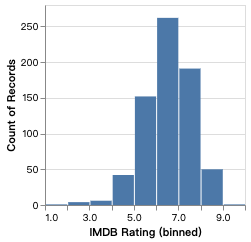

movies-scatter_29:scatter plot showing rotten tomatoes and IMDB ratings
clue: extract explicit attribute(['IMDB Rating'])
attribute info: 
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(scatterplot)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute,

movies-scatter_30:Scatter Plot of Rotten Tomatoes rating by the IMDB rating.


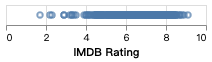

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_31:Relationship of Rotten Tomatoes rating to IMDB rating.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


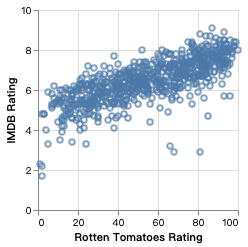

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_32:show me a scatterplot of rotten tomatoes ratings vs imdb ratings


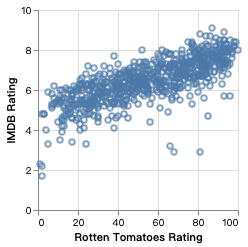

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


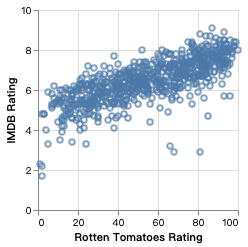

In [5]:
check('movies','scatter')

### 'movies','scatterColor'

dev distribution:
undefined: a new nl4dv instance
movies-scatterColor_1:Movie gross and budge relationship based on genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is d

movies-scatterColor_2:scatterplot budget and worldwide gross colored by genre
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Production Budget'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)


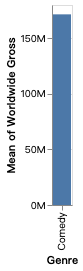

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.4
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 7.4
unmatch: for design[2](stripplot), directly give up this design since we have other design that can match the task better


movies-scatterColor_3:Scatter Production Budget vs Worldwide Gross. Color Code Major Genre.


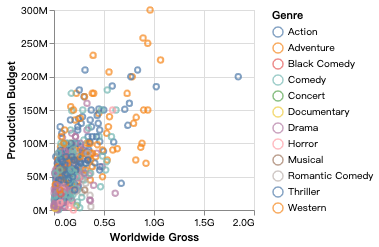

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support a

movies-scatterColor_4:Make a simple scatter plot of worldwide Gross by Production Budget categorized by Major Genre.


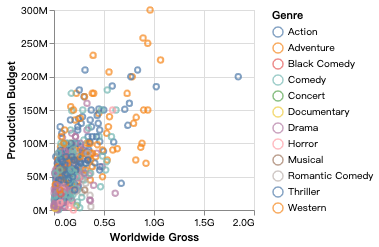

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support a

movies-scatterColor_5:Show how worldwide grosses are related to production budgets by genre.
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide grosses, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budgets, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


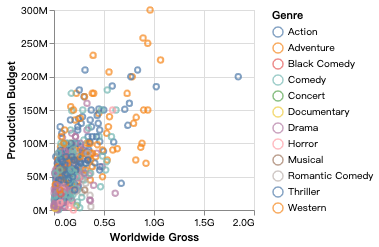

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.5
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.5
unmatch: for design[2](stripplot), directly give up this design since we have other des

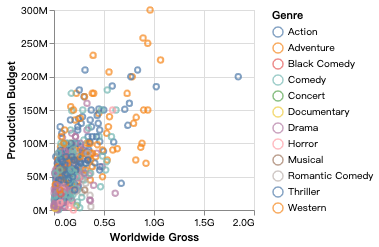

movies-scatterColor_6:Plot the worldwide gross versus production budget for individual movies, coloring each movie by its genre.
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == [

movies-scatterColor_7:What is the relationship between production budget and worldwide gross for each major genre?
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


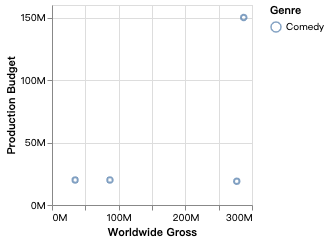

clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Worldwide Gross', 'Production Budget'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 7.0
implicit inference: for design[1](scat

movies-scatterColor_8:Scatterplot of Worldwide Gross by Production Budget with different colors by major genre
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword colors, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(scatterplot)


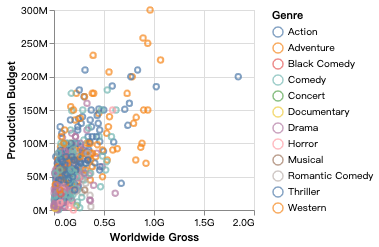

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['filter', 'correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 8.5
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attri

movies-scatterColor_9:give me wordwide gross versus production budget, colored by major genres
clue: extract explicit attribute(['Production Budget', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


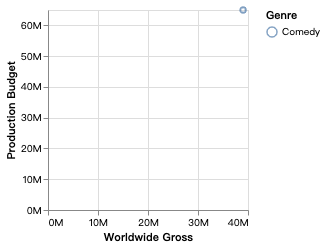

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.4
implicit inference: for design[1](scatterplot), since mandatory channel color 

movies-scatterColor_10:budget vs gross income across movie genres
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Production Budget', 'Title'])
attribute info: 
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


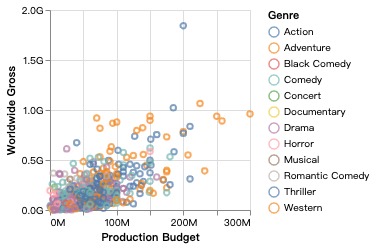

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['filter', 'correlation'])
unmatch: design for QQN does not support any extracted expli

movies-scatterColor_11:Give me a scatter plot of budget vs gross broken down by movie but with genre as a legend


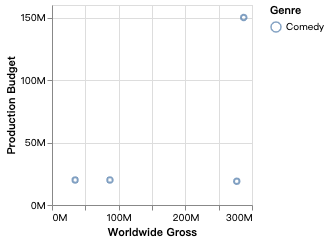

clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Production Budget', 'Title'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_synonym_match', 'attribute_domain_value_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_synonym_match', 'attribute_domain_value_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit '

movies-scatterColor_12:For each movie, show its budget and gross on a scatter plot and include the genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Production Budget', 'Title'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


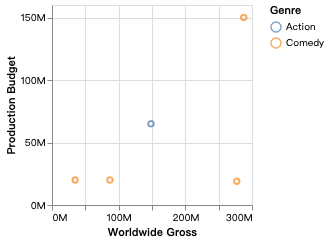

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, a

movies-scatterColor_13:scatter plot of production budget vs worldwide gross, colored by genre


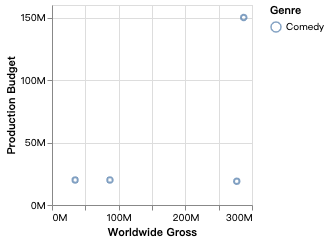

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 

movies-scatterColor_14:Chart scatter plot of production budget by worldwide growth coded by major genre


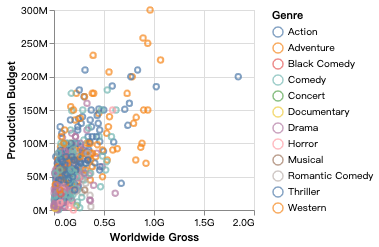

clue: extract explicit attribute(['Production Budget', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie',

movies-scatterColor_15:prod budget by gross for movies per genre
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Production Budget'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


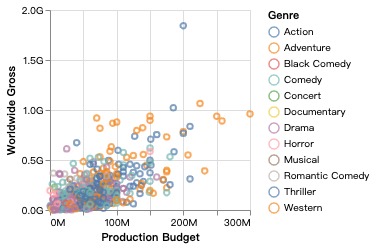

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, a

movies-scatterColor_16:plot all titles on a scatter plot chart by production budget an worldwide gross, and color the dots by major genre


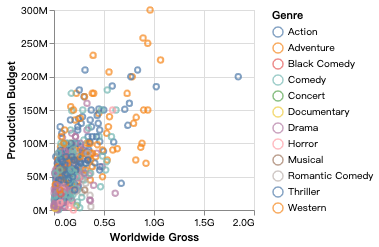

clue: extract explicit attribute(['Title', 'Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword titles, it maps to the following 1 attribute:
  Title(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  

movies-scatterColor_17:production budget vs ww gross by movie and major genre
clue: extract explicit attribute(['Production Budget', 'Genre', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


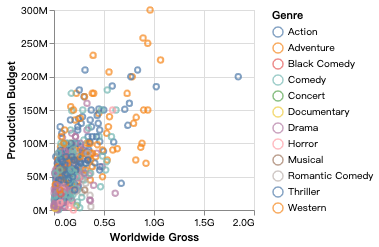

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['colors']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Primary Colors']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, a

movies-scatterColor_18:show the spread of production budget and worldwide gross for each movie with genre as a legend


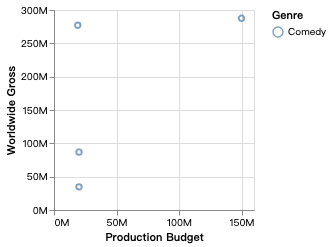

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre', 'Title'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_synonym_match', 'attribute_domain_value_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Mov

movies-scatterColor_19:Relation between worldwide gross and production budget for each major genre


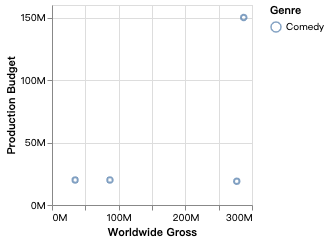

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie',

movies-scatterColor_20:Scatter Plot of Worldwide Gross by Production Budget with Major Genre labels


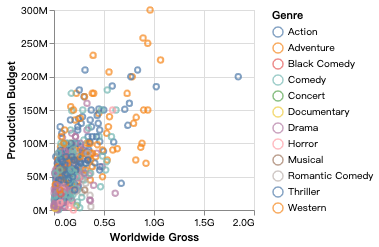

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 

movies-scatterColor_21:Worldwide Gross relationship to Production budget and Major Genre


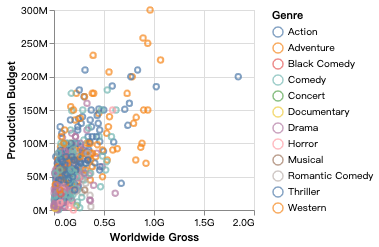

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Worldwide Gross', 'Genre'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchS

movies-scatterColor_22:show me a scatterplot of worldwide gross margin vs production budget; color movies by their genre


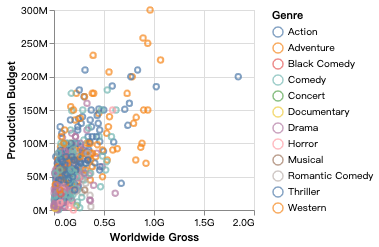

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 

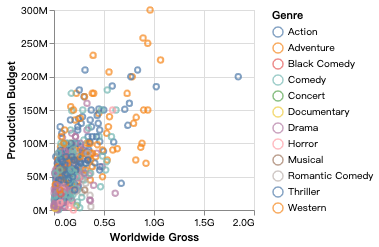

In [6]:
check('movies','scatterColor')

### 'movies','scatterFaceted'

dev distribution:
undefined: a new nl4dv instance
movies-scatterFaceted_1:give me scatterplots of worldwide gross versus production budget by different content ratings
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN su

movies-scatterFaceted_2:show me production budget against worldwide gross split by content rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


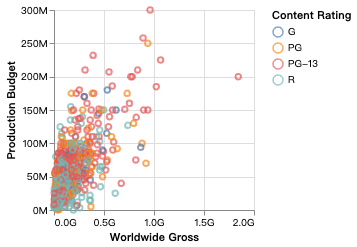

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.5
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 6.5
unmatch: for design[2](stripplot), directly give up this design since we have other design that can match the task better


movies-scatterFaceted_3:Scatter Production Budget vs Worldwide Gross | Slice by Content Rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


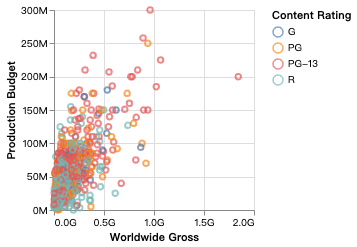

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.5
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](scatterplot), this design is append with score 7.5
unmatch: for design[2](stripplot), directly give up this design since we have other design that can match the task better


movies-scatterFaceted_4:Make simple scatter plots of the Worldwide Gross versus Production Budget. Parameterize by Content Rating.


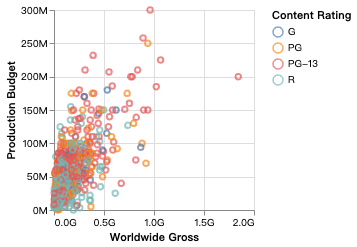

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.5
implicit inference: for design[1](scatterplot), sin

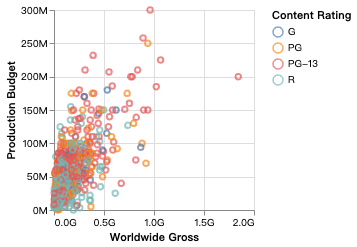

movies-scatterFaceted_5:Show how worldwide gross is related to production budgets for each content rating.
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budgets, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design 

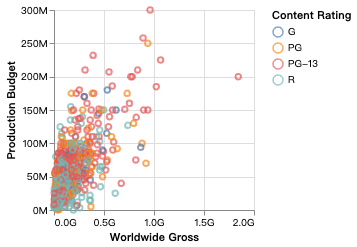

movies-scatterFaceted_6:Plot the worldwide gross v.s. production budget on a scatter plot, broken down by content rating.
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  fil

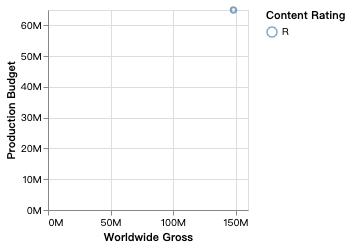

movies-scatterFaceted_7:Is there a relationship between production budget and worldwide gross for each content rating?
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Worldwide Gross', 'Production Budget'], operat

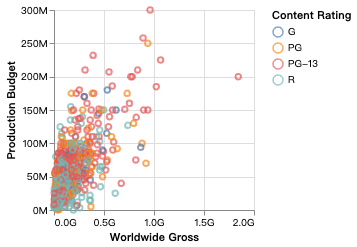

movies-scatterFaceted_8:Worldwide Gross by Production Budget by Rating in Scatterplot format
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (ex

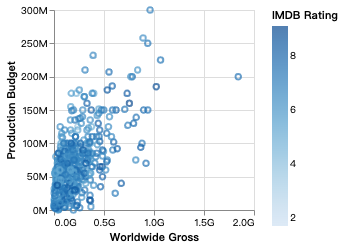

movies-scatterFaceted_9:Display budget by gross of movies broken down by content rating
clue: extract explicit attribute(['Content Rating', 'Worldwide Gross', 'Production Budget', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchSco

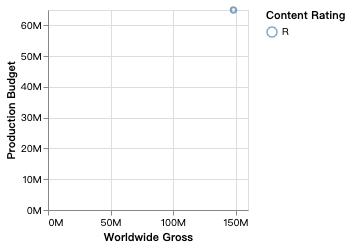

movies-scatterFaceted_10:Gross vs. production budget over different ratings 
clue: extract explicit attribute(['Production Budget', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword ratings, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_va

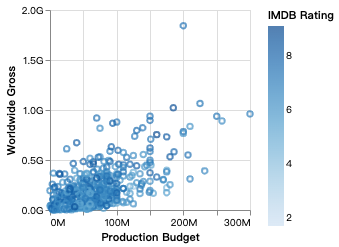

movies-scatterFaceted_11:Plot production budget against worldwide gross for the different rating categories of movies.
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value

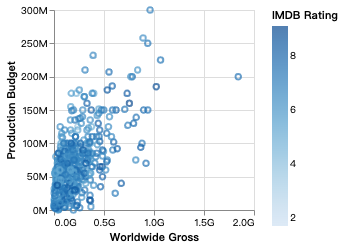

movies-scatterFaceted_12:production budget vs worldwide gross regarding movie rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis t

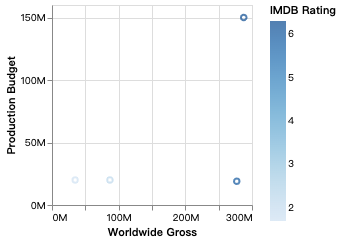

movies-scatterFaceted_13:Give me a scatter chart of production budget vs worldwide gross for each content rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken'])

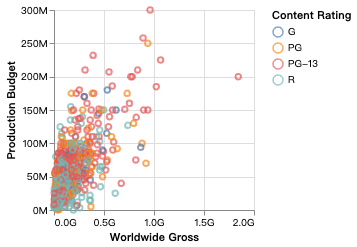

movies-scatterFaceted_14:For each content rating, compare budget vs gross in a scatter plot
clue: extract explicit attribute(['Content Rating', 'Worldwide Gross', 'Production Budget'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes

movies-scatterFaceted_15:scatter plot of production budget vs worldwide gross for G rated movies | scatter plot of production budget vs worldwide gross for PG rated movies | scatter plot of production budget vs worldwide gross for PG-13 rated movies | scatter plot of production budget vs worldwide gross for R rated movies


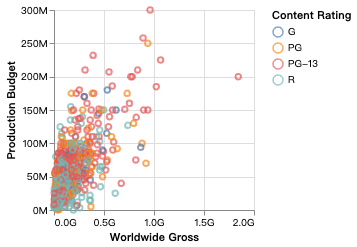

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rated, it maps to the following 2 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchS

movies-scatterFaceted_16:scatter(x=production budget,y=worldwide gross) for content rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


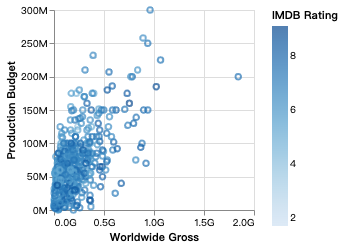

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.5
implicit inference: for design[1](scatterplot), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCC

movies-scatterFaceted_17:Chart scatter plot of worldwide gross by production budget broken down by content rating


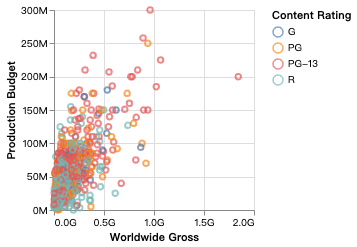

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(

movies-scatterFaceted_18:budget by worldwide gross per content rating
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Production Budget'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


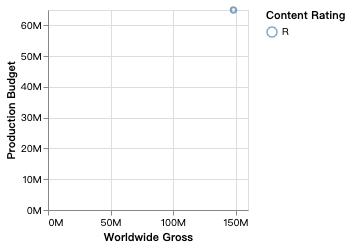

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.4
impli

movies-scatterFaceted_19:Show me scatterplots of production budget and woldwide gross for each title, by content rating
clue: extract explicit attribute(['Title', 'Production Budget', 'Content Rating', 'Worldwide Gross'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword title, it maps to the following 1 attribute:
  Title(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


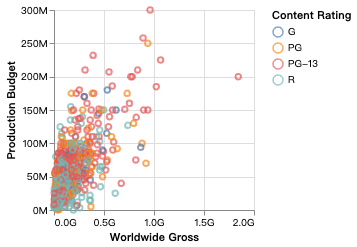

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
unmatch: design for QQN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 6.4
impli

movies-scatterFaceted_20:production budget vs ww gross for each movie, trellised by content rating
clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


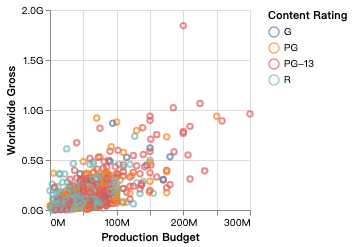

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['filter', 'co

movies-scatterFaceted_21:scatter charts for each content rating, showing production budget and ww gross for each movie 


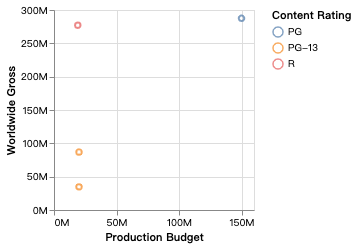

clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Worldwide Gross', 'Title'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(quer

movies-scatterFaceted_22:wordwide gross versus production budget for each content rating


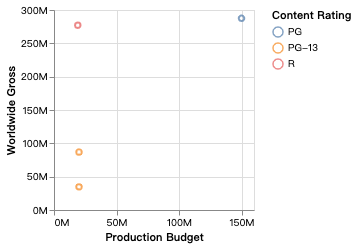

clue: extract explicit attribute(['Production Budget', 'Content Rating', 'Worldwide Gross'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie'

movies-scatterFaceted_23:Worldwide Gross relationship to Production Budget filtered by Content Rating


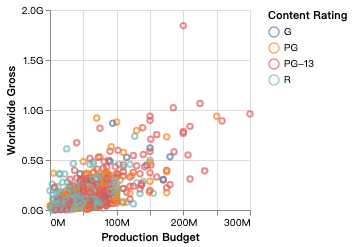

clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Worldwide Gross', 'Production Budget'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  f

movies-scatterFaceted_24:Worldwide Gross relationship to Production Budget separated by Content Rating
clue: extract explicit attribute(['Worldwide Gross', 'Production Budget', 'Content Rating'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


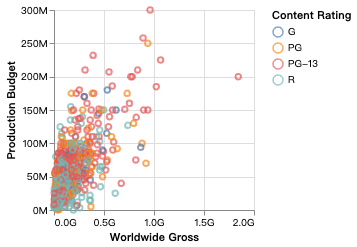

clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Worldwide Gross', 'Production Budget'], operator = None, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['broken']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = [

movies-scatterFaceted_25:show me scatter plots of movie production budget vs gross worldwide revenue broken down by rating


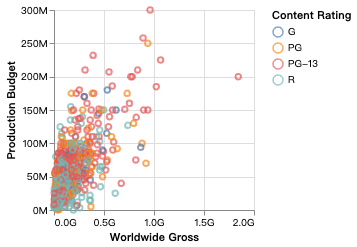

clue: extract explicit attribute(['Production Budget', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_matc

movies-scatterFaceted_26:show me small multiple scatter plots of movie production budget vs gross worldwide where each multiple is a specific rating


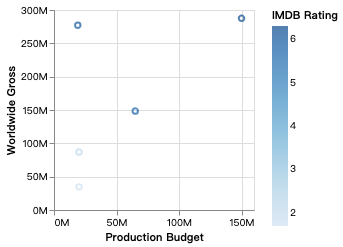

clue: extract explicit attribute(['Production Budget', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword production budget, it maps to the following 1 attribute:
  Production Budget(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword small, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match

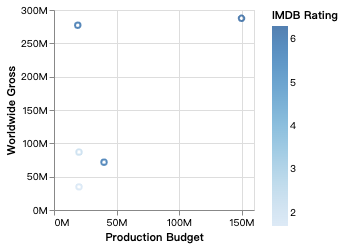

In [7]:
check('movies','scatterFaceted')

### 'movies','singleAttrBar'

dev distribution:
undefined: a new nl4dv instance
movies-singleAttrBar_1:histogram for creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(histogram)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(histogram)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.5


movies-singleAttrBar_2:show me bars | show me creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


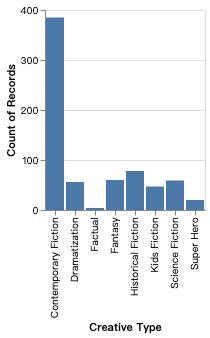

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_3:show me movies by creative types
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


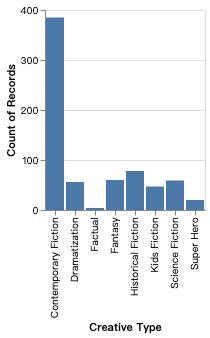

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_4:Show me count of movies categorized by creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


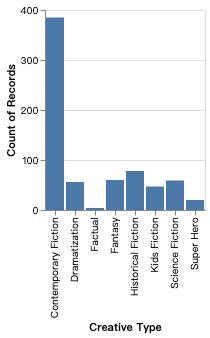

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_5:Make a simple bar chart of Count of Titles versus the category of Creative Type.


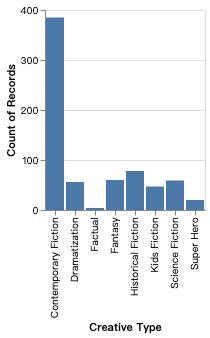

clue: extract explicit attribute(['Title', 'Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword titles, it maps to the following 1 attribute:
  Title(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.5


movies-singleAttrBar_6:How many movies are there are of each creative type?
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


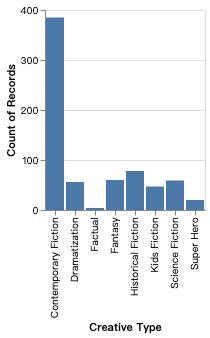

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_7:Which creative type had the most movies?
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


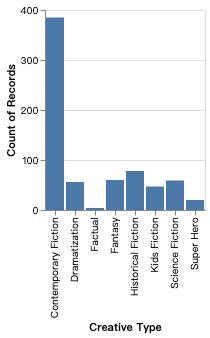

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_8:Which creative type had the fewest movies?
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


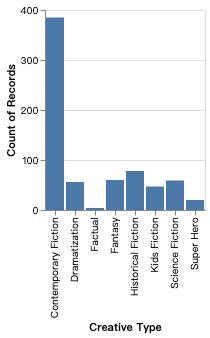

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_9:Count of movies by Creative Type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


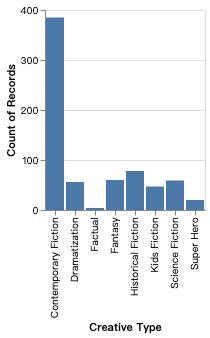

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_10:Movie count based on creative type
clue: extract explicit attribute(['Creative Type', 'Title'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


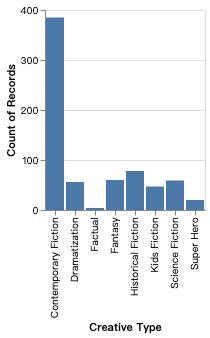

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['filter', 'distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.5


movies-singleAttrBar_11:Show a count of movies by creative type.
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


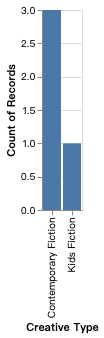

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_12:Count movies by creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


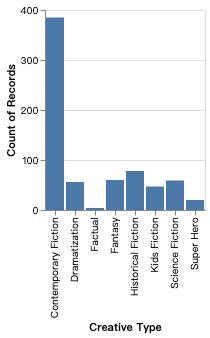

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_13:Which creative types have the most movies?
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


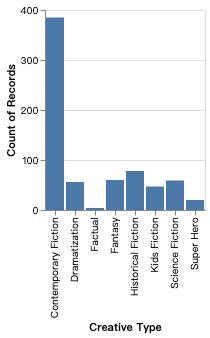

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_14:Sort creative types by number of movies
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


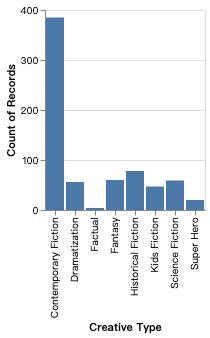

datatype_ambiguous: task is find_extremum, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['find_extremum'])
task info (explicit 'dependency analysis' task): 
for task type find_extremum, it has the following 1 task instance:
  find_extremum(queryPhrase == sort): matchScore = 1, attributes = ['Creative Type'], operator = MIN, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
unmatch: design for NN does not support any task in (['find_extremum'])
unmatch: design for NN does not support any extracted explicit vis type(None)
implicit inference: for design[0](scatterplot), since mandatory channel size is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for d

movies-singleAttrBar_15:Count of movies by creative type as a bar chart
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)


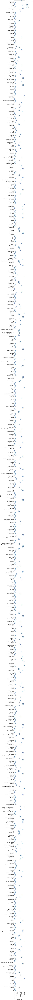

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.5


movies-singleAttrBar_16:bar chart of number of movies in each creative category
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(barchart)


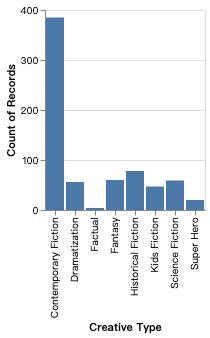

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.4


movies-singleAttrBar_17:Show me how many movies were made by creative type


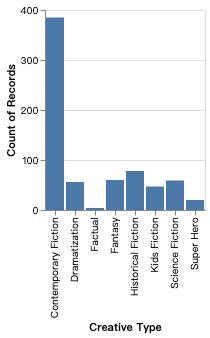

clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count

movies-singleAttrBar_18:counts of movies by creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


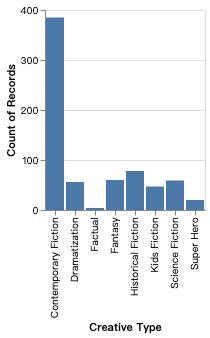

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_19:how many movies are there for each creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


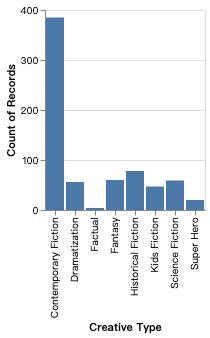

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_20:which creative types had the most movies?
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative types, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


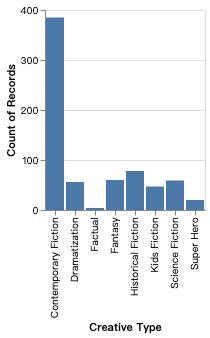

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_21:count of movies by creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


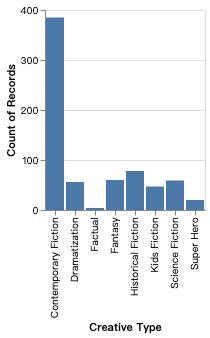

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_22:Create column graph of all movies by creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


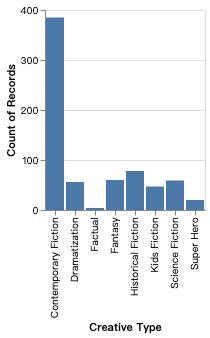

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_23:how many films of each creative type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


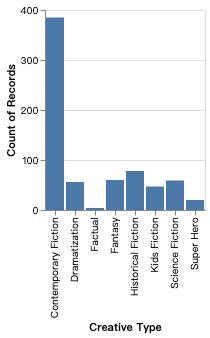

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_24:Count by Creative Type
clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


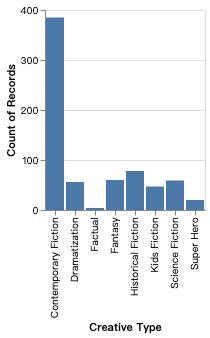

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 2.5


movies-singleAttrBar_25:show me a histogram of the count of each creative type, sorted in descending number of releases. 
clue: extract explicit attribute(['Creative Type', 'Release Year'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword releases, it maps to the following 1 attribute:
  Release Year(T): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(histogram)


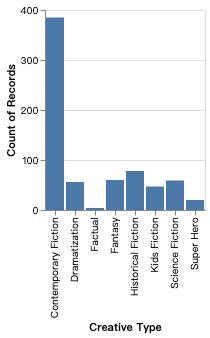

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is trend since we detect sorted_attr_datatype_combo_str(NT)
task info (implicit guess): 
  trend(queryPhrase == []): matchScore = 0.5, attributes = ['Creative Type', 'Release Year'], operator = None, values = None
clue: design for NT support at least one task in (['trend'])
unmatch: design for NT does not support any extracted explicit vis type(histogram)
implicit inference: for design[0](linechart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
Histogram not compatible / not supported for your query.
implicit inference: for design[1](linechart)

movies-singleAttrBar_26:show me the number of each creative type move in a bar chart, order the bars in decreasing order. 


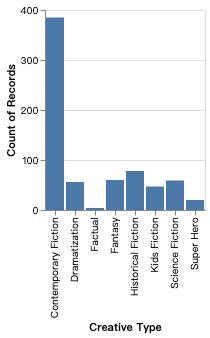

clue: extract explicit attribute(['Creative Type'])
attribute info: 
for keyword creative type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['distribution'])
implicit inference: for design[0](barchart), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](barchart), this design is append with score 3.5


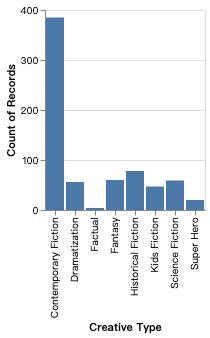

In [8]:
check('movies','singleAttrBar')

### 'movies','stackedBar'

dev distribution:
undefined: a new nl4dv instance
movies-stackedBar_1:Show the total worldwide gross by category of film, broken down by movie rating.
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword broken, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: ca

movies-stackedBar_2:Sum(Worldwide Gross) grouped by Genre and sub grouped by Content Rating
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


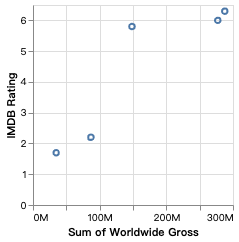

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == sum): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNN support at least one task in (['derived_value'])
unmatch: design for QNN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](barchart), this design is append with score 7.0
implicit inference: for design[1](barchart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCC

movies-stackedBar_3:Make a bar chart of the sum of Worldwide Gross as a function of the Major Genre.  | Split each bar by Content Rating. Put a legend of the Content Rating on the right. Alphabetize Content Rating.


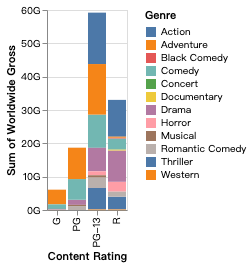

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword legend, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_synonym_match']
clue: extract explicit vis type(barchart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == sum): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'dom

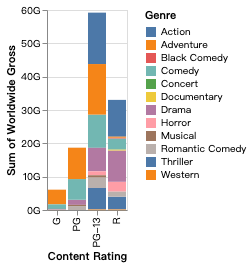

movies-stackedBar_4:Show how content ratings are associated with gross receipts by genre. 
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess

movies-stackedBar_5:Plot the total worldwide gross for each major genre using a stacked bar chart. Break down within each genre by content rating.


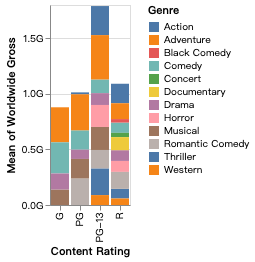

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attr

movies-stackedBar_6:Bar chart of total worldwide gross by major genre, by content rating
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)


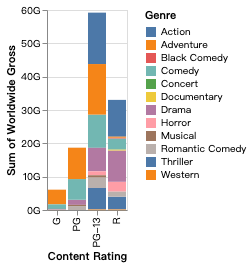

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNN support at least one task in (['derived_value'])
SUCCESS: for design[0](barchart), this design is append with score 8.0
implicit inference: for design[1](barchart), since mandatory channel color is not defined by any specific attribute, automatically use the attribute of the channel column and aggregation is None
SUCCESS: for design[1](barchart), this design is append with score 8.0
unmatch: f

movies-stackedBar_7:stacked bar of genre and worldwide gross colored by content rating


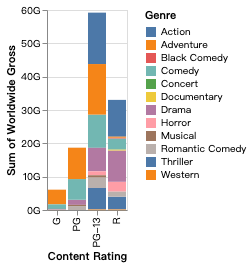

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info 

movies-stackedBar_8:give me a bar chart of worldwide gross sum by major genres stacked by content ratings
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)


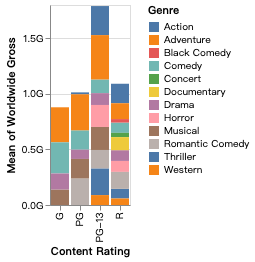

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 2 task instance:
  derived_value(queryPhrase == sum): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
  derived_value(queryPhrase == sum): matchScore = 1, attributes = ['Genre'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNN support at least one task in (['derived_value'])
auto correction: for design[0](barchart), since datatype_ambiguous problem happened in derived_value task, we give up modifying the design based on this ta

movies-stackedBar_9:Stack bar chart of SUM(worldwide gross) vs. movie genre based on content rating


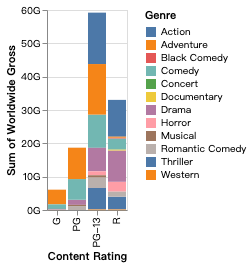

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre', 'Title'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
clue: extract explicit vis type(barchart)
datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == sum): matchScore =

movies-stackedBar_10:What is the total worldwide gross earned by each major genre and content rating?


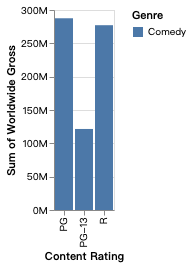

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, 

movies-stackedBar_11:Total ww gross by genre and content rating
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


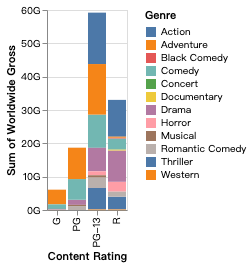

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Genre'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
clue: design for QNN support at least one task in (['derived_value'])
unmatch: design for QNN does not support any extracted explicit vis type(None)
auto correction: for design[

movies-stackedBar_12:Give me a stacked column chart of worldwide gross by genre and rating
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


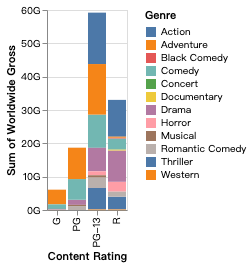

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'], operator = AVG, values = None
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QNN support at least on

movies-stackedBar_13:For each genre and rating, what is the total world-wide gross earnings?


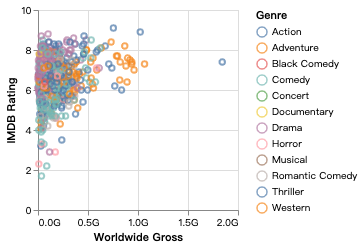

clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, 

movies-stackedBar_14:How much did each type of movie earn in across the whole world?
clue: extract explicit attribute(['Creative Type', 'Title'])
attribute info: 
for keyword type, it maps to the following 1 attribute:
  Creative Type(N): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type


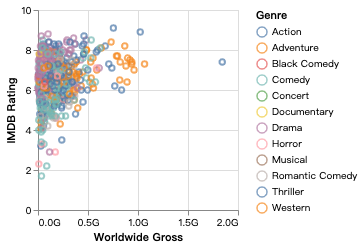

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(N)
clue: design for N support at least one task in (['filter', 'distribution'])
unmatch: design for N does not support any extracted explicit vis type(None)
implicit inference: for design[0](barchart), since mandatory channel y is not d

movies-stackedBar_15:Global boxoffice by genre and mpaa rating
clue: extract explicit attribute(['Genre', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])

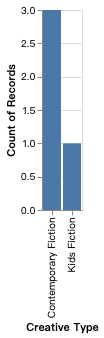


attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(qu

movies-stackedBar_16:How much money did movies of each genre and rating make?
clue: extract explicit attribute(['Genre', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])

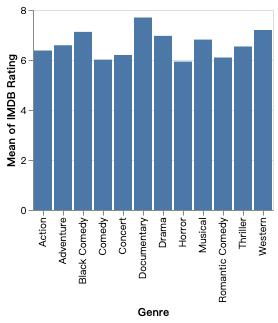


attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword money, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchSc

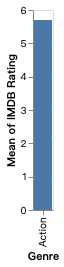

movies-stackedBar_17:Stacked bar chart of total worldwide gross for each genre, separated by rating
clue: extract explicit attribute(['Worldwide Gross', 'Genre', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the 

movies-stackedBar_18:Create stacked column graph of worldwide gross by major genre by content rating


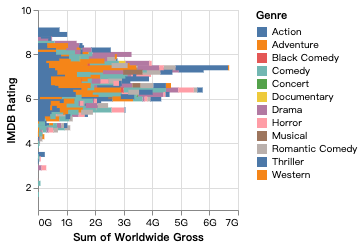

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 

movies-stackedBar_19:Show me the total worldwide gross for all major genres in a stacked bar chart and color it out by content rating
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)


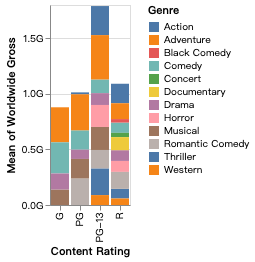

clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['money']): matchScore = 1, attributes = ['Title'], operator = IN, valu

movies-stackedBar_20:gross across genres regarding content rating
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword genres, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


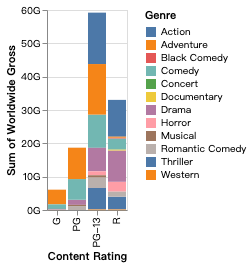

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['money']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Money Talks']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'

movies-stackedBar_21:ww gross by major genre and content rating
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


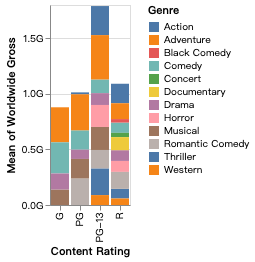

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['money']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Money Talks']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'

movies-stackedBar_22:total ww gross by genre and rating
clue: extract explicit attribute(['Genre', 'Worldwide Gross', 'Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword rating, it maps to the following 3 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


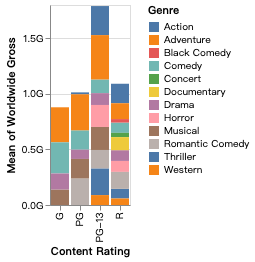

datatype_ambiguous: task is derived_value, but the corresponding attribute is not Q type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Genre'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPh

movies-stackedBar_23:Stacked bar chart of gross for each content rating, by major genre
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(barchart)


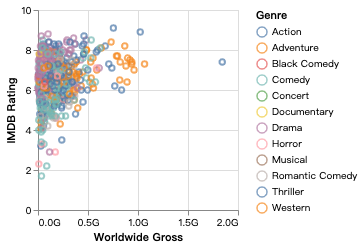

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['money']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Money Talks']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'

movies-stackedBar_24:Cumulative gross for each content rating, by major genre
clue: extract explicit attribute(['Content Rating', 'Genre', 'Worldwide Gross'])
attribute info: 
for keyword gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


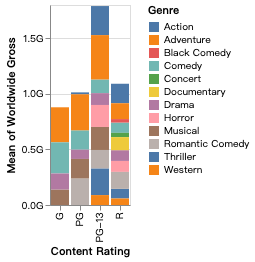

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Broken Arrow', 'Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
  filter(queryPhrase == ['money']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Money Talks']
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QNN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Worldwide Gross'

movies-stackedBar_25:Total Worldwide Gross by Major Genre separated by Content Rating


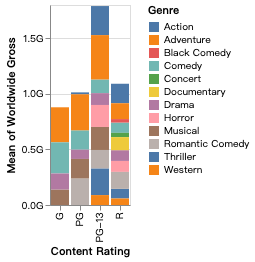

clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['broken', 'movie']): matchScore = 1, 

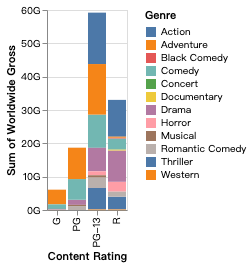

movies-stackedBar_26:Total Worldwide Gross by Major Genre with Content Rating labels
clue: extract explicit attribute(['Worldwide Gross', 'Content Rating', 'Genre'])
attribute info: 
for keyword genre, it maps to the following 1 attribute:
  Genre(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword content rating, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 1, metric = ['attribute_exact_match']
for keyword worldwide gross, it maps to the following 1 attribute:
  Worldwide Gross(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['derived_value'])
task info (explicit 'dependency analysis' task): 
for task type derived_value, it has the following 1 task instance:
  derived_value(queryPhrase == total): matchScore = 1, attributes = ['Worldwide Gross'], operator = SUM, values = []
clue: extract explicit 'domain_value filter' task
task info (explicit 

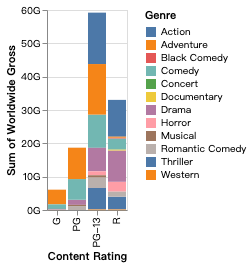

In [9]:
check('movies','stackedBar')

### 'movies','scatter'

dev distribution:
undefined: a new nl4dv instance
movies-scatter_1:Relationship between IMDB Rating and Rotten Tomatoes Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Rotten Tomatoes Rating', 'IMDB Rating'], operator = None, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QQ support at least one task in (['corre

movies-scatter_2:show me imdb rating versus rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


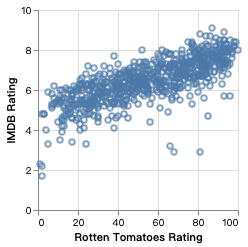

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_3:give me a scatterplot of imdb rating as x axis and rotten tomatoes rating as y axis
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


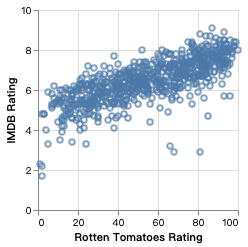

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_4:show me a scatterplot | show me rating | show me rotten tomatoes rating


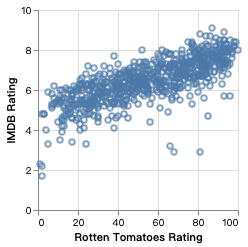

clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(scatterplot)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 3.5


movies-scatter_5:Plot IMDB rating against Rotten Tomatoes rating.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


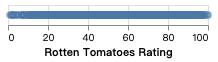

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


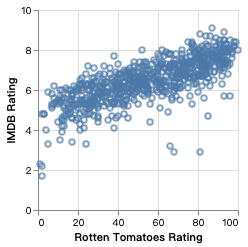

movies-scatter_6:scatter IMDB Rating vs Rotten Tomatoes Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_7:Make a simple scatter plot of Rotten Tomatoes Rating versus IMDB Rating.   | Use only major gridlines.


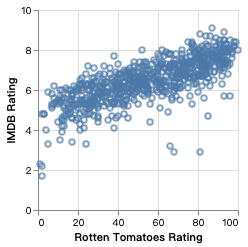

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_8:Show how films' Rotten Tomato ratings compare with IMDB ratings.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomato ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


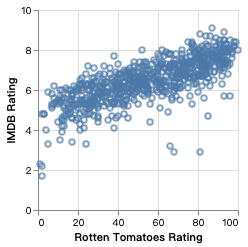

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


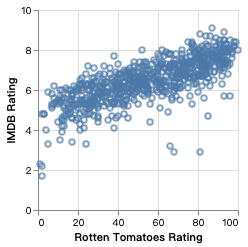

movies-scatter_9:Plot rotten tomatoes rating v.s. IMDB rating on a scatter plot.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_10:Is there a relationship between IMDB rating and rotten tomatoes rating?
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


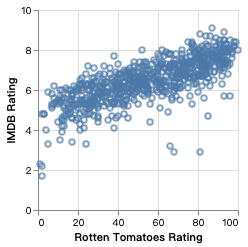

clue: extract explicit 'dependency analysis' task(['correlation'])
task info (explicit 'dependency analysis' task): 
for task type correlation, it has the following 1 task instance:
  correlation(queryPhrase == relationship): matchScore = 1, attributes = ['Rotten Tomatoes Rating', 'IMDB Rating'], operator = None, values = []
missing: cannot extract any explicit 'domain_value filter' task
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 5.0


movies-scatter_11:Scatterplot of Rotten Tomatoes Rating by IMDB Rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


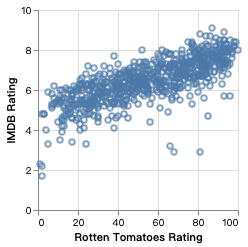

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_12:plot IMDB rating against rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


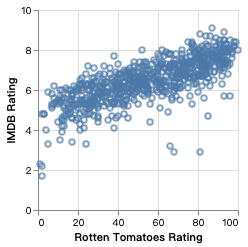

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_13:Are IMDb rating and rotten tomatoes rating related
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


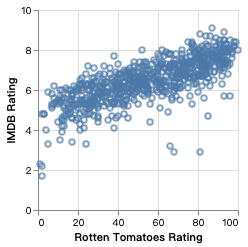

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_14:Rating of movies in IMBD and Rotten Tomatoes
clue: extract explicit attribute(['Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rating, it maps to the following 2 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
missing: cannot extract any explicit vis type


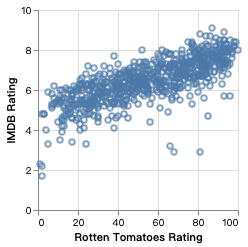

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is derived_value since we detect sorted_attr_datatype_combo_str(QN)
task info (implicit guess): 
  derived_value(queryPhrase == []): matchScore = 0.5, attributes = ['Rotten Tomatoes Rating'], operator = AVG, values = None
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QN support at least one task in (['derived_value', 'correlation'])
unmatch: design for QN does not support any extracted explicit vis type(None)
SUCCESS: for design[0](barchart), this design is append with score 3.8
unsuggested: for design[1](piechart), the design is not suggested by default
unsuggested: for design[2](donutchart), the design is not suggested by default
unmatch: for design[3](stripplot), directly give up this design since we have other design that can match the task better
clu

movies-scatter_15:how does Rotten Tomatoes Rating change as IMDB Rating?
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])

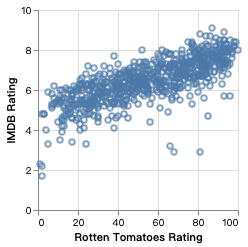


attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_16:Compare imdb rating to rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


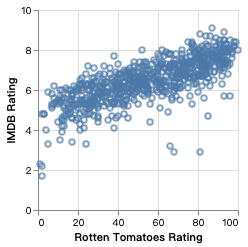

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


movies-scatter_17:Show a scatter plot of imdb rating vs rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


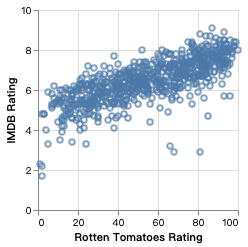

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_18:Give me a scatter plot showing a comparison of ratings between imdb and rotten tomatoes


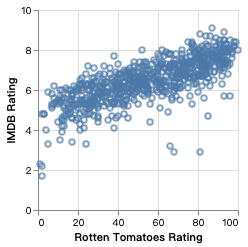

clue: extract explicit attribute(['Content Rating', 'Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword ratings, it maps to the following 1 attribute:
  Content Rating(N): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
for keyword imdb, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQN)
clue: design for QQN support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 7.2
implicit inference: for design[1](scatterplot), since m

movies-scatter_19:scatter plot of IMDB rating vs Rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)


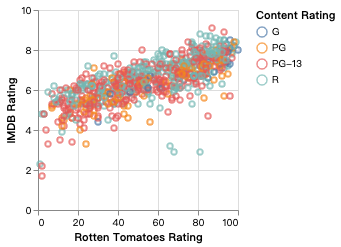

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


movies-scatter_20:Plot IMBD vs Rotten Tomatoes ratings for all movies
clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


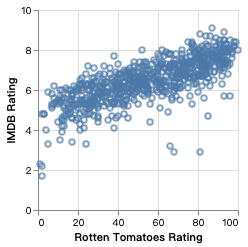

missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 2.5
SUCCESS: for design[2](boxplot), this design is append with score 2.5


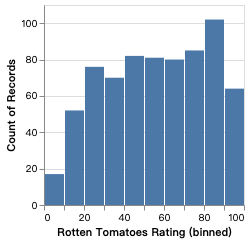

movies-scatter_21:Help me see outliers in IMDB and Rotten Tomatoes ratings
clue: extract explicit attribute(['Rotten Tomatoes Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for 

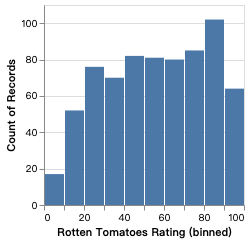

movies-scatter_22:IMDB rating by rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design for QQ does not support any extracted explicit vis type(None)
SUCCESS: for design[0](scatterplot), this design is append with score 4.5


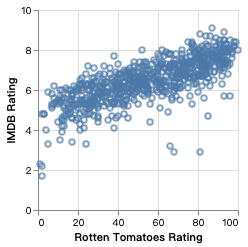

movies-scatter_23:Show me a scatterplot of movies by imdb rating and rotten tomatoes rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.5


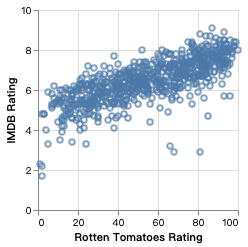

movies-scatter_24:scatter of imdb rating by rotting tomatoes rating
clue: extract explicit attribute(['IMDB Rating', 'Rotten Tomatoes Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword tomatoes, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 0.9, metric = ['attribute_similarity_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
missing: cannot extract any explicit 'domain_value filter' task
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for design[0](scatterplot), this design is append with score 5.4


movies-scatter_25:imdb rating vs rotten tomatoes rating by movie


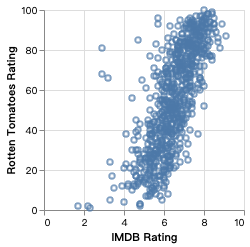

clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating', 'Title'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword movie, it maps to the following 1 attribute:
  Title(N): matchScore = 0.5, metric = ['attribute_domain_value_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for Q

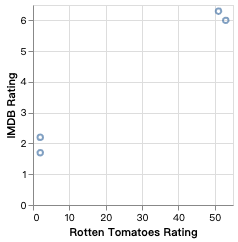

movies-scatter_26:Create scatter graph of IMDB rating by Rotten Tomatoes Rating 
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: 

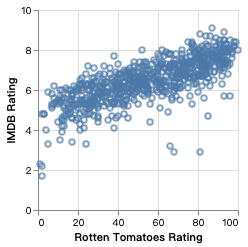

movies-scatter_27:relation between rotten tomatoes rating and IMDB rating
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design

movies-scatter_28:relation between rotten tomatoes and IMDB ratings
clue: extract explicit attribute(['IMDB Rating'])
attribute info: 
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type


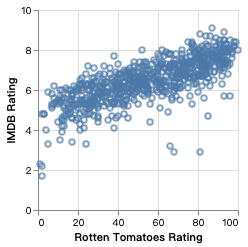

missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(None)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute, automatically use the attribute of the channel x and aggregation is count
SUCCESS: for design[0](histogram), this design is append with score 2.5
SUCCESS: for design[1](stripplot), this design is append with score 2.5
SUCCESS: for design[2](boxplot), this design is append with score 2.5


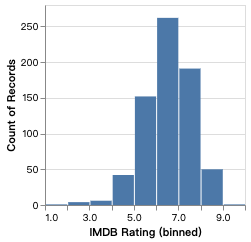

movies-scatter_29:scatter plot showing rotten tomatoes and IMDB ratings
clue: extract explicit attribute(['IMDB Rating'])
attribute info: 
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is distribution since we detect sorted_attr_datatype_combo_str(Q)
clue: design for Q support at least one task in (['distribution'])
unmatch: design for Q does not support any extracted explicit vis type(scatterplot)
implicit inference: for design[0](histogram), since mandatory channel y is not defined by any specific attribute,

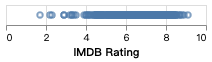

movies-scatter_30:Scatter Plot of Rotten Tomatoes rating by the IMDB rating.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCESS: for 

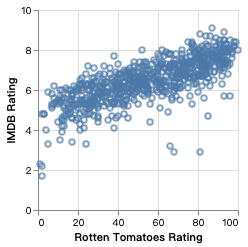

movies-scatter_31:Relationship of Rotten Tomatoes rating to IMDB rating.
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes rating, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb rating, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
missing: cannot extract any explicit vis type
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
unmatch: design 

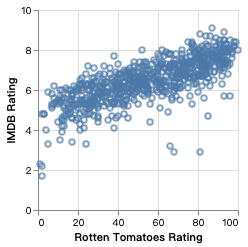

movies-scatter_32:show me a scatterplot of rotten tomatoes ratings vs imdb ratings
clue: extract explicit attribute(['Rotten Tomatoes Rating', 'IMDB Rating'])
attribute info: 
for keyword rotten tomatoes ratings, it maps to the following 1 attribute:
  Rotten Tomatoes Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
for keyword imdb ratings, it maps to the following 1 attribute:
  IMDB Rating(Q): matchScore = 1, metric = ['attribute_exact_match']
clue: extract explicit vis type(scatterplot)
missing: cannot extract any explicit 'dependency analysis' task
clue: extract explicit 'domain_value filter' task
task info (explicit 'domain_value' task): 
  filter(queryPhrase == ['movie']): matchScore = 1, attributes = ['Title'], operator = IN, values = ['Bee Movie', 'Disaster Movie', 'Scary Movie', 'Epic Movie']
implicit inference: guess the task is correlation since we detect sorted_attr_datatype_combo_str(QQ)
clue: design for QQ support at least one task in (['correlation'])
SUCCE

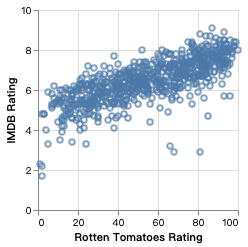

In [10]:
check('movies','scatter')

### END